# Variational autoencoders

In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as func

import torchvision as vision
import torchvision.transforms as transforms

import matplotlib.pyplot as plt

#from tqdm import tqdm
from tqdm import tqdm_notebook as tqdm

from sklearn.manifold import TSNE

from torch.autograd import Variable

import numpy as np

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

cuda:0


In [ ]:
transform = transforms.Compose([
    transforms.ToTensor(),
])

mnist_train = vision.datasets.MNIST('./mnist', train=True, download=True, transform=transform)
train = torch.utils.data.DataLoader(mnist_train, batch_size=600, shuffle=True)

### 1. Autoencoders

In [ ]:
def Train(autoencoder_, epoch_n = 20):
    last_error = 1
    for i in range(1, epoch_n+1):
        for j, (X, y) in enumerate(tqdm(train, desc=f'epoch {i}')):
            X = X.to(device)
            X_hat = autoencoder_(X)
            error = loss(X, X_hat)
            optimizer.zero_grad()
            error.backward()
            if j != 0 and j % (len(train) - 1) == 0:
                print("error", error.item())
                if error.item() > last_error:
                    optimizer.step()
                    return
                last_error = error.item()
            optimizer.step()

In [ ]:
def draw_axis(autoencoder_):
    X = torch.cat([torch.unsqueeze(mnist_train[i][0], 0) for i in range(1000)])
    y = torch.Tensor([mnist_train[i][1] for i in range(1000)])

    X = X.to(device)

    h = autoencoder_.encode(X).cpu().detach().numpy()
    h = TSNE(n_components=2).fit_transform(h)

    plt.figure(figsize=(12, 6))
    plt.title('Mnist embeddings')
    scatter = plt.scatter(h[:, 0], h[:, 1], c=y)
    plt.legend(*scatter.legend_elements(), title="Digits")
    plt.grid()

In [ ]:
def draw_samples(autoencoder_, numbers = 5):
    X = torch.cat([torch.unsqueeze(mnist_train[i][0], 0) for i in range(1000)])
    y = torch.Tensor([mnist_train[i][1] for i in range(1000)])
    
    X = X.to(device)

    height, width = numbers * 2, 2
    
    X_hat = autoencoder_(X).cpu().detach().numpy()

    plt.figure(figsize=(4, numbers * 4))
    for i in range(0, numbers):
        plt.subplot(height, width, i * 2 + 1)
        plt.title(f'Digit {int(y[i])}')
        plt.imshow(X.cpu()[i][0], cmap='gray')
        plt.axis('off')
        
        plt.subplot(height, width, i * 2 + 2)
        plt.title(f'New digit {int(y[i])}')
        plt.imshow(X_hat[i][0], cmap='gray')
        plt.axis('off')

In [ ]:
class Autoencoder(nn.Module):
    def __init__(self):
        super(Autoencoder, self).__init__()
        self.size = 28*28
        self.encoder = nn.Linear(self.size, 10)
        self.decoder = nn.Linear(10, self.size)
        
        
    def encode(self, X):
        X = X.view(-1, self.size)
        X = self.encoder(X)
        X = func.relu(X)
        return X
        
    def decode(self, X):
        X = self.decoder(X)
        X = torch.sigmoid(X)
        X = X.view(-1, 1, 28, 28)
        return X
        
    def forward(self, X):
        return self.decode(self.encode(X))

In [ ]:
autoencoder = Autoencoder().to(device)
loss = nn.MSELoss()
optimizer = torch.optim.Adam(autoencoder.parameters(), lr=1e-3)
Train(autoencoder, 20)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  after removing the cwd from sys.path.


error 0.08444404602050781



error 0.06529223918914795



error 0.05915927141904831



error 0.05453283712267876



error 0.049822527915239334



error 0.04726804420351982



error 0.0445525199174881



error 0.043684449046850204



error 0.04262594133615494



error 0.04186345636844635



error 0.041887424886226654


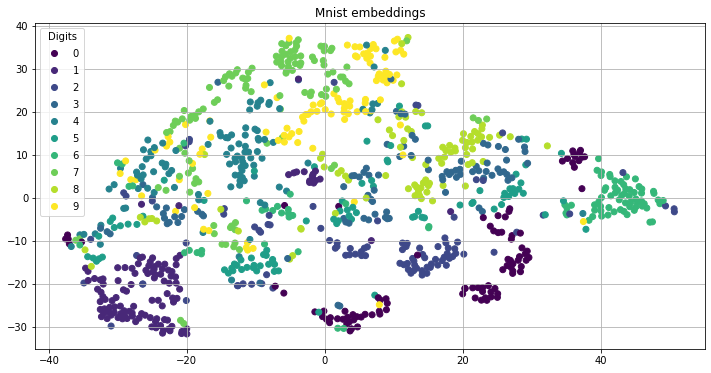

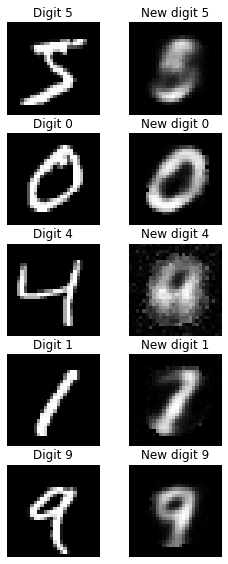

In [ ]:
draw_axis(autoencoder)
draw_samples(autoencoder, 5)

In [ ]:
class Autoencoder2(nn.Module):
    def __init__(self):
        super(Autoencoder2, self).__init__()
        self.size = 28*28
        
        self.encoder = nn.Sequential(
            nn.Linear(self.size, 400),
            nn.ReLU(),
            nn.Linear(400, 10),
            nn.ReLU()
        )
        
        self.decoder = nn.Sequential(
            nn.Linear(10, 400),
            nn.ReLU(),
            nn.Linear(400, self.size),
            nn.Sigmoid()
        )
        
    def encode(self, X):
        X = X.view(-1, self.size)
        X = self.encoder(X)
        return X
        
    def decode(self, X):
        X = self.decoder(X)
        X = X.view(-1, 1, 28, 28)
        return X
        
    def forward(self, X):
        return self.decode(self.encode(X))
    
autoencoder2 = Autoencoder2().to(device)
loss = nn.MSELoss()
optimizer = torch.optim.Adam(autoencoder2.parameters(), lr=1e-3)
Train(autoencoder2, 20)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  after removing the cwd from sys.path.


error 0.050834737718105316



error 0.03603971749544144



error 0.03291286155581474



error 0.02840813808143139



error 0.02711610309779644



error 0.025918401777744293



error 0.026065750047564507


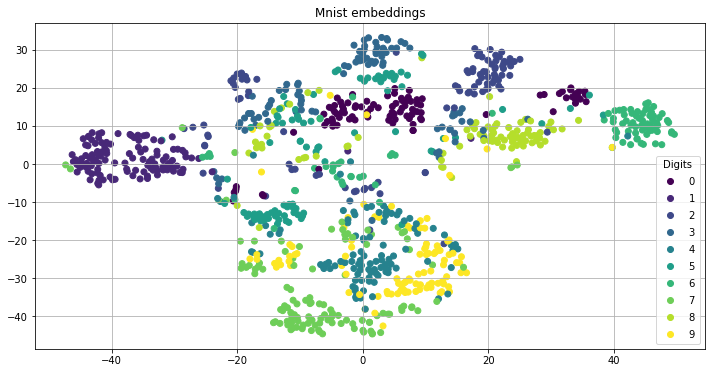

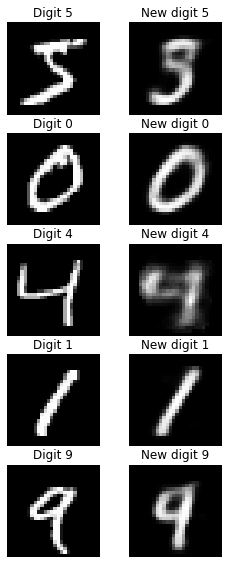

In [ ]:
draw_axis(autoencoder2)
draw_samples(autoencoder2, 5)

In [ ]:
class Autoencoder3(nn.Module):
    def __init__(self):
        super(Autoencoder3, self).__init__()
        self.size = 28*28
        
        self.encoder = nn.Sequential(
            nn.Linear(self.size, 400),
            nn.ReLU(),
            nn.Linear(400, 200),
            nn.ReLU(),
            nn.Linear(200, 10),
            nn.ReLU()
        )
        
        self.decoder = nn.Sequential(
            nn.Linear(10, 200),
            nn.ReLU(),
            nn.Linear(200, 400),
            nn.ReLU(),
            nn.Linear(400, self.size),
            nn.Sigmoid()
        )
        
    def encode(self, X):
        X = X.view(-1, self.size)
        X = self.encoder(X)
        return X
        
    def decode(self, X):
        X = self.decoder(X)
        X = X.view(-1, 1, 28, 28)
        return X
        
    def forward(self, X):
        return self.decode(self.encode(X))
    
autoencoder3 = Autoencoder3().to(device)
loss = nn.MSELoss()
optimizer = torch.optim.Adam(autoencoder3.parameters(), lr=1e-3)
Train(autoencoder3, 20)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  after removing the cwd from sys.path.


error 0.06096361204981804



error 0.041337862610816956



error 0.03237007558345795



error 0.02999293804168701



error 0.027533942833542824



error 0.026299314573407173



error 0.024403585121035576



error 0.024675941094756126


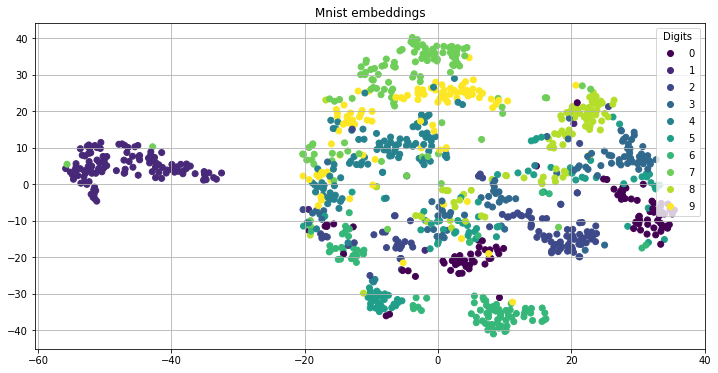

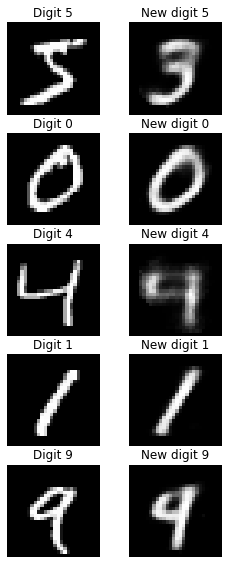

In [ ]:
draw_axis(autoencoder3)
draw_samples(autoencoder3, 5)

In [ ]:
class Autoencoder4(nn.Module):
    def __init__(self):
        super(Autoencoder4, self).__init__()
        self.size = 28*28
        
        self.encoder = nn.Sequential(
            nn.Linear(self.size, 400),
            nn.ReLU(),
            nn.Linear(400, 200),
            nn.ReLU(),
            nn.Linear(200, 20),
            nn.ReLU()
        )
        
        self.decoder = nn.Sequential(
            nn.Linear(20, 200),
            nn.ReLU(),
            nn.Linear(200, 400),
            nn.ReLU(),
            nn.Linear(400, self.size),
            nn.Sigmoid()
        )
        
    def encode(self, X):
        X = X.view(-1, self.size)
        X = self.encoder(X)
        return X
        
    def decode(self, X):
        X = self.decoder(X)
        X = X.view(-1, 1, 28, 28)
        return X
        
    def forward(self, X):
        return self.decode(self.encode(X))
    
autoencoder4 = Autoencoder4().to(device)
loss = nn.MSELoss()
optimizer = torch.optim.Adam(autoencoder4.parameters(), lr=1e-3)
Train(autoencoder4, 20)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  after removing the cwd from sys.path.


error 0.06208070367574692



error 0.038850460201501846



error 0.03225673735141754



error 0.0264115072786808



error 0.024596495553851128



error 0.022366628050804138



error 0.021299438551068306



error 0.020433811470866203



error 0.019970597699284554



error 0.019196288660168648



error 0.01920928806066513


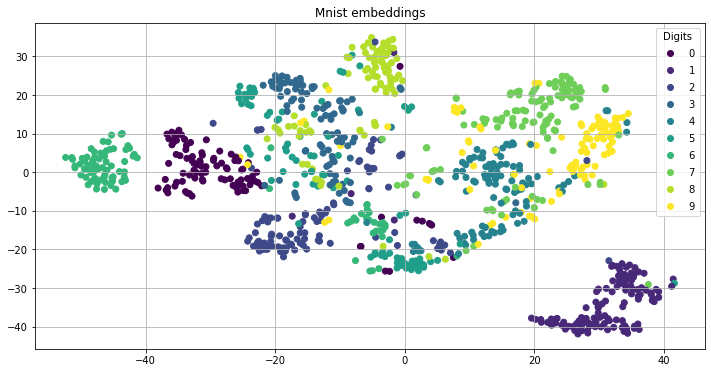

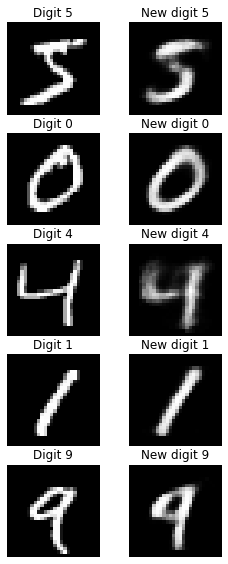

In [ ]:
draw_axis(autoencoder4)
draw_samples(autoencoder4, 5)

In [ ]:
class Autoencoder5(nn.Module):
    def __init__(self):
        super(Autoencoder5, self).__init__()
        self.size = 28*28
        
        self.encoder = nn.Sequential(
            nn.Linear(self.size, 254),
            nn.ReLU(),
            nn.Linear(254, 128),
            nn.ReLU(),
            nn.Linear(128, 64),
            nn.ReLU(),
            nn.Linear(64, 32),
            nn.ReLU(),
            nn.Linear(32, 16),
            nn.ReLU()
        )
        
        self.decoder = nn.Sequential(
            nn.Linear(16, 32),
            nn.ReLU(),
            nn.Linear(32, 64),
            nn.ReLU(),
            nn.Linear(64, 128),
            nn.ReLU(),
            nn.Linear(128, 254),
            nn.ReLU(),
            nn.Linear(254, self.size),
            nn.Sigmoid()
        )
        
    def encode(self, X):
        X = X.view(-1, self.size)
        X = self.encoder(X)
        return X
        
    def decode(self, X):
        X = self.decoder(X)
        X = X.view(-1, 1, 28, 28)
        return X
        
    def forward(self, X):
        return self.decode(self.encode(X))
    
autoencoder5 = Autoencoder5().to(device)
loss = nn.MSELoss()
optimizer = torch.optim.Adam(autoencoder5.parameters(), lr=1e-3)
Train(autoencoder5, 20)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  after removing the cwd from sys.path.


error 0.06662429124116898



error 0.05535030737519264



error 0.051701776683330536



error 0.049726009368896484



error 0.04162290692329407



error 0.03841238468885422



error 0.03580080345273018



error 0.032474126666784286



error 0.03124644048511982



error 0.03027438558638096



error 0.028947614133358



error 0.029654258862137794


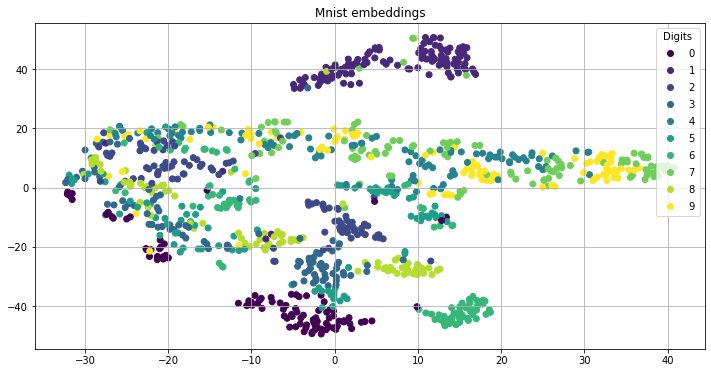

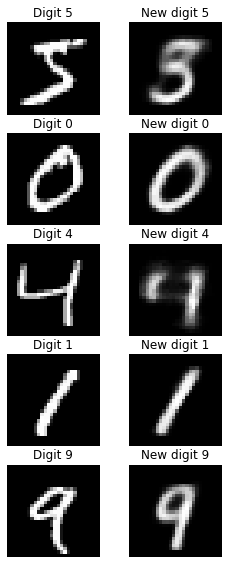

In [ ]:
draw_axis(autoencoder5)
draw_samples(autoencoder5, 5)

In [ ]:
X = torch.cat([torch.unsqueeze(mnist_train[i][0], 0) for i in range(1000)])
X = X.to(device)

h = autoencoder4.encode(X).cpu().detach().numpy()
max_h = 0
min_h = 0
for elem in h:
    max_e = max(elem)
    min_e = min(elem)
    if max_e > max_h:
        max_h = max_e
    if min_e < min_h:
        min_h = min_e
print(max_h)
print(min_h)
print(autoencoder4.encode(X)[0])

29.558945
0
tensor([ 0.0000,  0.0000,  0.0000,  0.0000,  7.1423,  0.0000,  0.0000,  9.8061,
        11.9105,  0.0000, 11.6462, 14.4776,  0.0000,  0.0000,  5.6672, 14.8532,
         5.0272,  9.2339, 15.8417,  4.9762], device='cuda:0',
       grad_fn=<SelectBackward>)


In [ ]:
def draw_random(autoencoder_, r1 = -20, r2 = 20, lines = 2, emb = 10):
    height, width = lines, 8
    size = lines * 8
    new_X = autoencoder_.decode(((r1 - r2) * torch.rand(size, emb) + r2).to(device)).cpu().detach().numpy()

    plt.figure(figsize=(16, lines * 2))
    for i in range(0, size):
        plt.subplot(height, width, i+1)
        plt.imshow(new_X[i][0], cmap='gray')
        plt.axis('off')

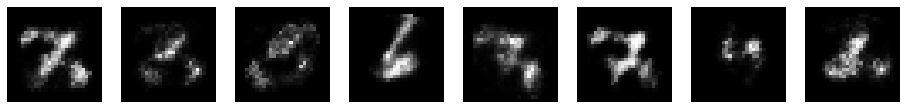

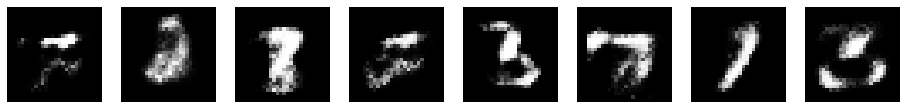

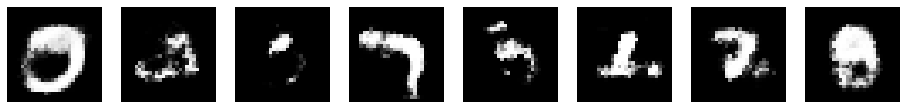

In [ ]:
draw_random(autoencoder3, 0, 10, 1, 10)
draw_random(autoencoder3, 0, 20, 1, 10)
draw_random(autoencoder3, 0, 30, 1, 10)

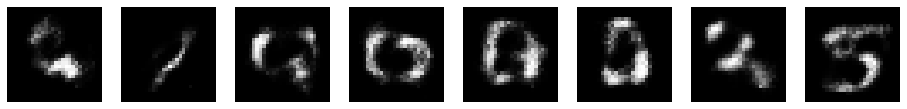

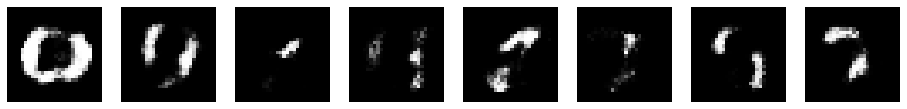

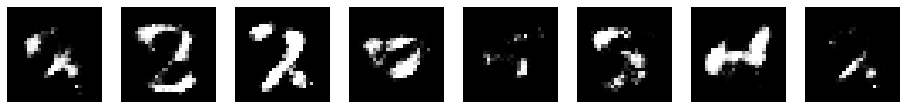

In [ ]:
draw_random(autoencoder4, 0, 10, 1, 20)
draw_random(autoencoder4, 0, 20, 1, 20)
draw_random(autoencoder4, 0, 30, 1, 20)

In [ ]:
from skimage.util import random_noise

def draw_samples_with_s_and_p(autoencoder_, numbers = 5, amount = 0.2):
    X = torch.cat([torch.unsqueeze(mnist_train[i][0], 0) for i in range(1000)])
    y = torch.Tensor([mnist_train[i][1] for i in range(1000)])

    X = X.to(device)
    
    height, width = numbers * 3, 3
    
    X_s_and_p = torch.tensor(random_noise(X.cpu(), mode='s&p', amount = amount, salt_vs_pepper=0.5, clip=True)).to(device)
    X_s_and_p_hat = autoencoder_(X_s_and_p).cpu().detach().numpy()

    plt.figure(figsize=(5, numbers * 5))
    for i in range(0, numbers):
        plt.subplot(height, width, i * 3 + 1)
        plt.title(f'Digit {int(y[i])}')
        plt.imshow(X.cpu()[i][0], cmap='gray')
        plt.axis('off')
        
        plt.subplot(height, width, i * 3 + 2)
        plt.title(f'Salt and pepper {int(y[i])}')
        plt.imshow(X_s_and_p.cpu()[i][0], cmap='gray')
        plt.axis('off')
        
        plt.subplot(height, width, i * 3 + 3)
        plt.title(f'New digit {int(y[i])}')
        plt.imshow(X_s_and_p_hat[i][0], cmap='gray')
        plt.axis('off')

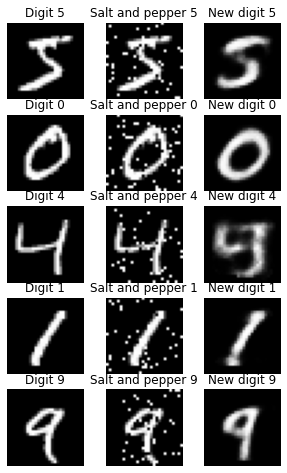

In [ ]:
draw_samples_with_s_and_p(autoencoder4, 5, 0.1)

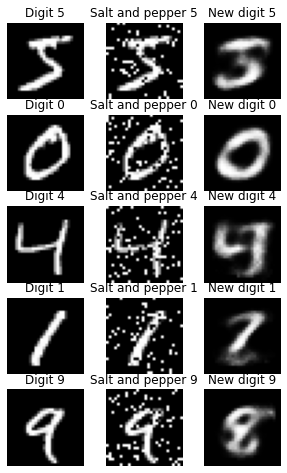

In [ ]:
draw_samples_with_s_and_p(autoencoder4, 5, 0.2)

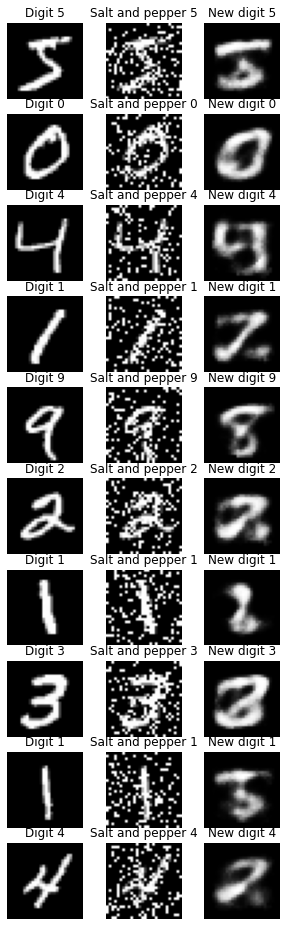

In [ ]:
draw_samples_with_s_and_p(autoencoder4, 10, 0.3)

### 2. Variational autoencoders

In [ ]:
def draw_axis_VAE(VAE_):
    X = torch.cat([torch.unsqueeze(mnist_train[i][0], 0) for i in range(1000)])
    y = torch.Tensor([mnist_train[i][1] for i in range(1000)])

    X = X.to(device)

    h = VAE_.encode(X)[0].cpu().detach().numpy()
    h = TSNE(n_components=2).fit_transform(h)

    plt.figure(figsize=(12, 6))
    plt.title('Mnist embeddings')
    scatter = plt.scatter(h[:, 0], h[:, 1], c=y)
    plt.legend(*scatter.legend_elements(), title="Digits")
    plt.grid()

In [ ]:
def draw_samples_VAE(VAE_, numbers = 5):
    X = torch.cat([torch.unsqueeze(mnist_train[i][0], 0) for i in range(1000)])
    y = torch.Tensor([mnist_train[i][1] for i in range(1000)])
    
    X = X.to(device)

    height, width = numbers * 2, 2
    X_hat = VAE_(X)[0].cpu().detach().numpy()

    plt.figure(figsize=(4, numbers * 4))
    for i in range(0, numbers):
        plt.subplot(height, width, i * 2 + 1)
        plt.title(f'Digit {int(y[i])}')
        plt.imshow(X.cpu()[i][0], cmap='gray')
        plt.axis('off')
        
        plt.subplot(height, width, i * 2 + 2)
        plt.title(f'New digit {int(y[i])}')
        plt.imshow(X_hat[i][0], cmap='gray')
        plt.axis('off')

In [ ]:
def loss_function(input, output, mu, gamma):
    loss = nn.MSELoss(size_average=False)
    BCE = loss(output, input)
    KLD = -0.5 * torch.sum(1 + gamma - mu.pow(2) - gamma.exp())
    return BCE + KLD

In [ ]:
def Train_VAE(VAE_, epoch_n = 20):
    last_error = 100000
    for i in range(1, epoch_n+1):
        for j, (X, y) in enumerate(tqdm(train, desc=f'epoch {i}')):
            X = X.to(device)
            optimizer.zero_grad()

            X_hat, m, g = VAE_(X)
            error = loss_function(X, X_hat, m, g)
            error.backward()
            if j != 0 and j % (len(train) - 1) == 0:
                print("error", error.item() / len(train))
                if error.item() / len(train) > last_error:
                    optimizer.step()
                    return
                last_error = error.item() / len(train)
            optimizer.step()

In [ ]:
class VAE(nn.Module):
    def __init__(self):
        super(VAE, self).__init__()
        self.size = 28*28
        
        self.encoder = nn.Sequential(
            nn.Linear(self.size, 400),
            nn.ReLU(),
            nn.Linear(400, 200),
            nn.ReLU()
        )

        self.mu = nn.Linear(200, 20)
        self.gamma = nn.Linear(200, 20)
        
        self.decoder = nn.Sequential(
            nn.Linear(20, 200),
            nn.ReLU(),
            nn.Linear(200, 400),
            nn.ReLU(),
            nn.Linear(400, self.size),
            nn.Sigmoid()
        )
        
    def encode(self, X):
        X = X.view(-1, self.size)
        
        X = self.encoder(X)
        mu = self.mu(X)
        gamma = self.gamma(X)
        return mu, gamma
    
    def reparameterize(self, mu, gamma):
        sigma = torch.exp(0.5 * gamma)
        eps = torch.randn_like(sigma)
        return eps.mul(sigma).add(mu)
        
    def decode(self, X):
        X = self.decoder(X)
        X = X.view(-1, 1, 28, 28)
        return X
        
    def forward(self, X):
        mu, gamma = self.encode(X)
        X = self.reparameterize(mu, gamma)
        X = self.decode(X)
        return X, mu, gamma

In [ ]:
VAE = VAE().to(device)
optimizer = torch.optim.Adam(VAE.parameters(), lr=1e-3)
Train_VAE(VAE, 20)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  after removing the cwd from sys.path.


/usr/local/lib/python3.6/dist-packages/torch/nn/_reduction.py:44: UserWarning: size_average and reduce args will be deprecated, please use reduction='sum' instead.
  warnings.warn(warning.format(ret))


error 313.7337890625



error 280.307421875



error 243.4418359375



error 221.30673828125



error 215.52796875



error 203.6551953125



error 200.34927734375



error 197.576015625



error 189.17390625



error 191.5624609375


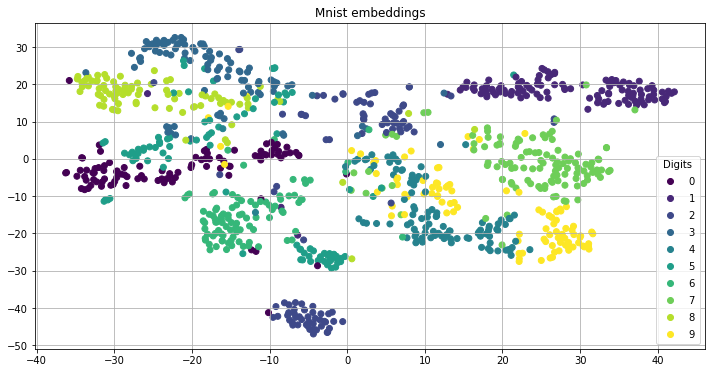

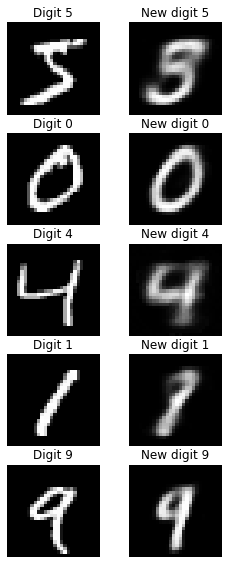

In [ ]:
draw_axis_VAE(VAE)
draw_samples_VAE(VAE, 5)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  after removing the cwd from sys.path.


/usr/local/lib/python3.6/dist-packages/torch/nn/_reduction.py:44: UserWarning: size_average and reduce args will be deprecated, please use reduction='sum' instead.
  warnings.warn(warning.format(ret))


error 305.03916015625



error 278.7045703125



error 236.39318359375



error 214.60236328125



error 206.442734375



error 199.300625



error 194.1891015625



error 190.1623046875



error 190.667421875


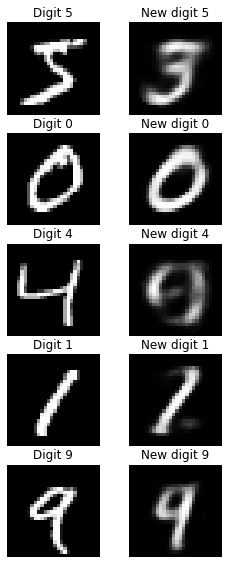

In [ ]:
class VAE2(nn.Module):
    def __init__(self):
        super(VAE2, self).__init__()
        self.size = 28*28
        
        self.encoder = nn.Sequential(
            nn.Linear(self.size, 400),
            nn.ReLU(),
            nn.Linear(400, 200),
            nn.ReLU()
        )

        self.mu = nn.Linear(200, 10)
        self.gamma = nn.Linear(200, 10)
        
        self.decoder = nn.Sequential(
            nn.Linear(10, 200),
            nn.ReLU(),
            nn.Linear(200, 400),
            nn.ReLU(),
            nn.Linear(400, self.size),
            nn.Sigmoid()
        )
        
    def encode(self, X):
        X = X.view(-1, self.size)
        
        X = self.encoder(X)
        mu = self.mu(X)
        gamma = self.gamma(X)
        return mu, gamma
    
    def reparameterize(self, mu, gamma):
        sigma = torch.exp(0.5 * gamma)
        eps = torch.randn_like(sigma)
        return eps.mul(sigma).add(mu)
        
    def decode(self, X):
        X = self.decoder(X)
        X = X.view(-1, 1, 28, 28)
        return X
        
    def forward(self, X):
        mu, gamma = self.encode(X)
        X = self.reparameterize(mu, gamma)
        X = self.decode(X)
        return X, mu, gamma

VAE2 = VAE2().to(device)
optimizer = torch.optim.Adam(VAE2.parameters(), lr=1e-3)
Train_VAE(VAE2, 20)
draw_samples_VAE(VAE2, 5)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  after removing the cwd from sys.path.


/usr/local/lib/python3.6/dist-packages/torch/nn/_reduction.py:44: UserWarning: size_average and reduce args will be deprecated, please use reduction='sum' instead.
  warnings.warn(warning.format(ret))


error 311.15798828125



error 270.6200390625



error 235.99853515625



error 209.895625



error 202.24146484375



error 198.6125



error 193.16203125



error 188.30546875



error 184.2521875



error 182.052890625



error 181.90974609375



error 183.39033203125


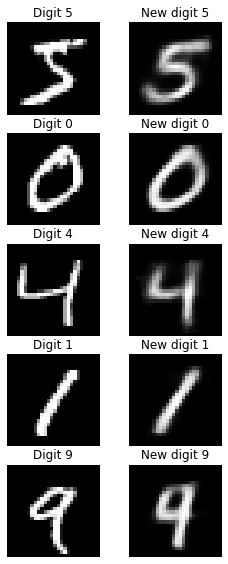

In [ ]:
class VAE3(nn.Module):
    def __init__(self):
        super(VAE3, self).__init__()
        self.size = 28*28
        
        self.encoder = nn.Sequential(
            nn.Linear(self.size, 512),
            nn.ReLU(),
            nn.Linear(512, 256),
            nn.ReLU()
        )

        self.mu = nn.Linear(256, 10)
        self.gamma = nn.Linear(256, 10)
        
        self.decoder = nn.Sequential(
            nn.Linear(10, 256),
            nn.ReLU(),
            nn.Linear(256, 512),
            nn.ReLU(),
            nn.Linear(512, self.size),
            nn.Sigmoid()
        )
        
    def encode(self, X):
        X = X.view(-1, self.size)
        
        X = self.encoder(X)
        mu = self.mu(X)
        gamma = self.gamma(X)
        return mu, gamma
    
    def reparameterize(self, mu, gamma):
        sigma = torch.exp(0.5 * gamma)
        eps = torch.randn_like(sigma)
        return eps.mul(sigma).add(mu)
        
    def decode(self, X):
        X = self.decoder(X)
        X = X.view(-1, 1, 28, 28)
        return X
        
    def forward(self, X):
        mu, gamma = self.encode(X)
        X = self.reparameterize(mu, gamma)
        X = self.decode(X)
        return X, mu, gamma

VAE3 = VAE3().to(device)
optimizer = torch.optim.Adam(VAE3.parameters(), lr=1e-3)
Train_VAE(VAE3, 20)
draw_samples_VAE(VAE3, 5)

In [ ]:
def draw_random_VAE(VAE_, lines = 2, emb = 20):
    height, width = lines, 8
    size = lines * 8
    X = torch.randn(size, emb).to(device)
    new_X = VAE_.decode(X).cpu().detach().numpy()

    plt.figure(figsize=(16, lines * 2))
    for i in range(0, size):
        plt.subplot(height, width, i+1)
        plt.imshow(new_X[i][0], cmap='gray')
        plt.axis('off')

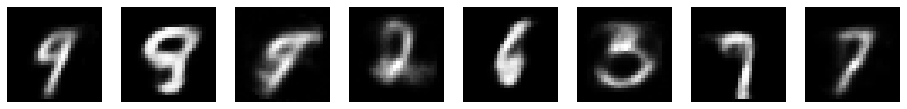

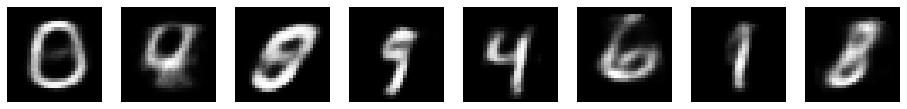

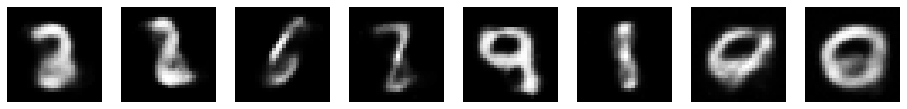

In [ ]:
draw_random_VAE(VAE, 1, 20)
draw_random_VAE(VAE2, 1, 10)
draw_random_VAE(VAE3, 1, 10)

In [2]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [3]:
import gdown
import os

url = 'https://drive.google.com/uc?id=1cNIac61PSA_LqDFYFUeyaQYekYPc75NH'
data_root = '/content/gdrive/My Drive/Colab Notebooks/celeba'
data_folder = '/content/gdrive/My Drive/Colab Notebooks/celeba/img_align_celeba'
download_path = f'{data_root}/celeba.zip'
if not os.path.exists(data_root):
    os.makedirs(data_root)
if not os.path.exists(data_folder):
    os.makedirs(data_folder)

#gdown.download(url, download_path, quiet=False)

In [4]:
import zipfile

#with zipfile.ZipFile(download_path, 'r') as ziphandler:
#    ziphandler.extractall(data_folder)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


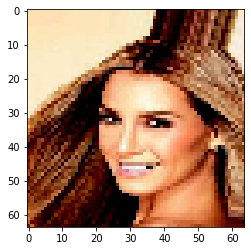

In [10]:
import os
from PIL import Image
from natsort import natsorted

img_size = 64
transform = transforms.Compose(
    [transforms.ToTensor(),
     transforms.Resize((img_size, img_size)),
     transforms.CenterCrop(img_size),
     transforms.Normalize((0.2), (0.8))
    ])

class CoolCelebaDataset(torch.utils.data.Dataset):
    def __init__(self):
        root_dir = f'{data_folder}/img_align_celeba'
        image_names = os.listdir(root_dir)
        self.root_dir = root_dir
        self.transform = transform
        self.image_names = natsorted(image_names)
    
    def __getitem__(self, idx):
        img_path = os.path.join(self.root_dir, self.image_names[idx])
        img = Image.open(img_path).convert('RGB')  
        img = self.transform(img)
        return img
    
    def __len__(self):
        return len(self.image_names)
        
cool_celeba_dataset = CoolCelebaDataset()
#print(len(cool_celeba_dataset))
plt.imshow(cool_celeba_dataset[0].permute(1, 2, 0))

In [26]:
def draw_samples_Celeba_VAE(VAE_, numbers = 5, dataset=cool_celeba_dataset):
    X = torch.cat([torch.unsqueeze(dataset[i], 0) for i in range(numbers)])
    
    X = X.to(device)

    height, width = numbers * 2, 2
    X_hat = VAE_(X)[0]

    plt.figure(figsize=(4, numbers * 4))
    for i in range(0, numbers):
        plt.subplot(height, width, i * 2 + 1)
        plt.title(f'Image')
        plt.imshow(np.clip(X[i].permute(1, 2, 0).cpu(), 0, 1))
        plt.axis('off')
        
        plt.subplot(height, width, i * 2 + 2)
        plt.title(f'New image')
        plt.imshow(np.clip(X_hat[i].permute(1, 2, 0).cpu().detach().numpy(), 0, 1))
        plt.axis('off')
    plt.show()

In [32]:
def draw_random_Celeba_VAE(VAE_, lines = 2, emb = 20):
    height, width = lines, 8
    size = lines * 8
    X = torch.randn(size, emb).to(device)
    new_X = VAE_.decode(X).cpu()

    plt.figure(figsize=(16, lines * 2))
    for i in range(0, size):
        plt.subplot(height, width, i+1)
        plt.imshow(np.clip(new_X[i].permute(1, 2, 0).detach().numpy(), 0, 1))
        plt.axis('off')
    plt.show()

In [28]:
def loss_function_celeba(input, output, mu, gamma):
    
    loss = nn.MSELoss(size_average=False)
    BCE = loss(output, input)
    KLD = -0.5 * torch.sum(1 + gamma - mu.pow(2) - gamma.exp())
    return BCE + KLD

In [29]:
def Train_Celeba_VAE(VAE_, epoch_n = 20, show = False, inter = 100, emb = 30,
                     stop = True):
    last_error = 100000
    for i in range(1, epoch_n+1):
        for j, (X) in enumerate(tqdm(celeba_train, desc=f'epoch {i}')):
            X = X.to(device)
            optimizer.zero_grad()

            X_hat, m, g = VAE_(X)
            error = loss_function_celeba(X, X_hat, m, g)
            error.backward()
            if j != 0 and j % (len(celeba_train) - 1) == 0:
                print("error", error.item() / len(celeba_train))
                if stop and error.item() / len(celeba_train) > last_error:
                    optimizer.step()
                    return
                last_error = error.item() / len(celeba_train)
            optimizer.step()
            if show and j != 0 and j % inter == 0:
                print("epoch", i, ":", j)
                draw_samples_Celeba_VAE(VAE_, numbers = 5)
                draw_random_Celeba_VAE(VAE_, lines = 2, emb=emb)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  after removing the cwd from sys.path.


/usr/local/lib/python3.6/dist-packages/torch/nn/_reduction.py:44: UserWarning: size_average and reduce args will be deprecated, please use reduction='sum' instead.
  warnings.warn(warning.format(ret))


error 1808.5551108374384



error 1582.284790640394



error 1491.2096674876848



error 1409.8731527093596



error 1361.3405172413793



error 1350.45289408867



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


error 1396.1493226600985


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


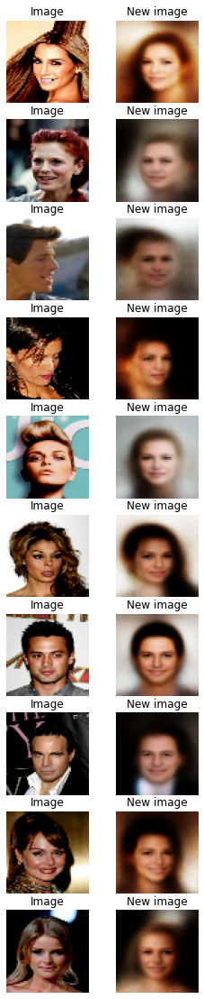

In [ ]:
class CelebaVAE(nn.Module):
    def __init__(self):
        super(CelebaVAE, self).__init__()
        self.size = 3 * 64 * 64
        
        self.encoder = nn.Sequential(
            nn.Linear(self.size, 512),
            nn.ReLU(),
            nn.Linear(512, 256),
            nn.ReLU()
        )

        self.mu = nn.Linear(256, 20)
        self.gamma = nn.Linear(256, 20)
        
        self.decoder = nn.Sequential(
            nn.Linear(20, 256),
            nn.ReLU(),
            nn.Linear(256, 512),
            nn.ReLU(),
            nn.Linear(512, self.size),
            nn.Sigmoid()
        )
        
    def encode(self, X):
        X = X.view(-1, self.size)
        
        X = self.encoder(X)
        mu = self.mu(X)
        gamma = self.gamma(X)
        return mu, gamma
    
    def reparameterize(self, mu, gamma):
        sigma = torch.exp(0.5 * gamma)
        eps = torch.randn_like(sigma)
        return eps.mul(sigma).add(mu)
        
    def decode(self, X):
        X = self.decoder(X)
        X = X.view(-1, 3, 64, 64)
        return X
        
    def forward(self, X):
        mu, gamma = self.encode(X)
        X = self.reparameterize(mu, gamma)
        X = self.decode(X)
        return X, mu, gamma

celeba_train = torch.utils.data.DataLoader(cool_celeba_dataset, 
                                                   batch_size=1000, shuffle=True)
CelebaVAE = CelebaVAE().to(device)
optimizer = torch.optim.Adam(CelebaVAE.parameters(), lr=1e-3)
Train_Celeba_VAE(CelebaVAE, 20)
draw_samples_Celeba_VAE(CelebaVAE, 10)

203


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  after removing the cwd from sys.path.


/usr/local/lib/python3.6/dist-packages/torch/nn/_reduction.py:44: UserWarning: size_average and reduce args will be deprecated, please use reduction='sum' instead.
  warnings.warn(warning.format(ret))


error 2311.979371921182



error 1805.4976908866995



error 1596.1517857142858



error 1496.304802955665



error 1445.0264778325122



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


error 1455.4556650246304


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


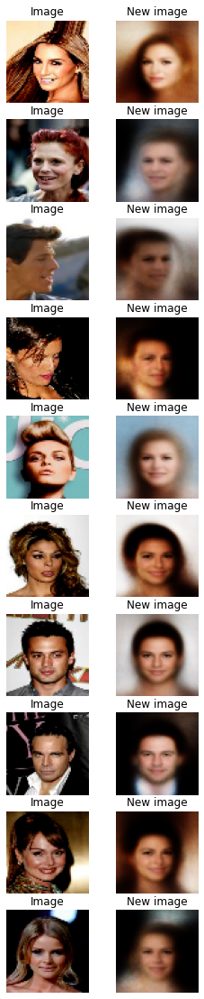

In [ ]:
class CelebaVAE2(nn.Module):
    def __init__(self):
        super(CelebaVAE2, self).__init__()
        self.size = 3 * 64 * 64
        
        self.encoder = nn.Sequential(
            nn.Linear(self.size, 1024),
            nn.ReLU(),
            nn.Linear(1024, 512),
            nn.ReLU(),
            nn.Linear(512, 256),
            nn.ReLU()
        )

        self.mu = nn.Linear(256, 30)
        self.gamma = nn.Linear(256, 30)
        
        self.decoder = nn.Sequential(
            nn.Linear(30, 256),
            nn.ReLU(),
            nn.Linear(256, 512),
            nn.ReLU(),
            nn.Linear(512, 1024),
            nn.ReLU(),
            nn.Linear(1024, self.size),
            nn.Sigmoid()
        )
        
    def encode(self, X):
        X = X.view(-1, self.size)
        
        X = self.encoder(X)
        mu = self.mu(X)
        gamma = self.gamma(X)
        return mu, gamma
    
    def reparameterize(self, mu, gamma):
        sigma = torch.exp(0.5 * gamma)
        eps = torch.randn_like(sigma)
        return eps.mul(sigma).add(mu)
        
    def decode(self, X):
        X = self.decoder(X)
        X = X.view(-1, 3, 64, 64)
        return X
        
    def forward(self, X):
        mu, gamma = self.encode(X)
        X = self.reparameterize(mu, gamma)
        X = self.decode(X)
        return X, mu, gamma

celeba_train = torch.utils.data.DataLoader(cool_celeba_dataset, 
                                                   batch_size=1000, shuffle=True)
print(len(celeba_train))
CelebaVAE2 = CelebaVAE2().to(device)
optimizer = torch.optim.Adam(CelebaVAE2.parameters(), lr=1e-3)
Train_Celeba_VAE(CelebaVAE2, 20)
draw_samples_Celeba_VAE(CelebaVAE2, 10)

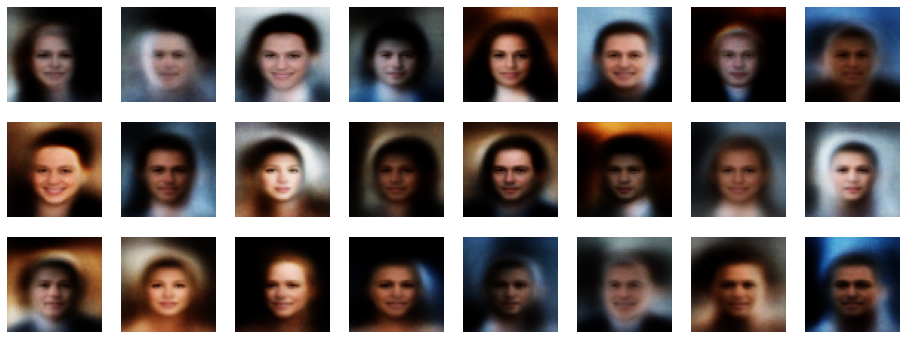

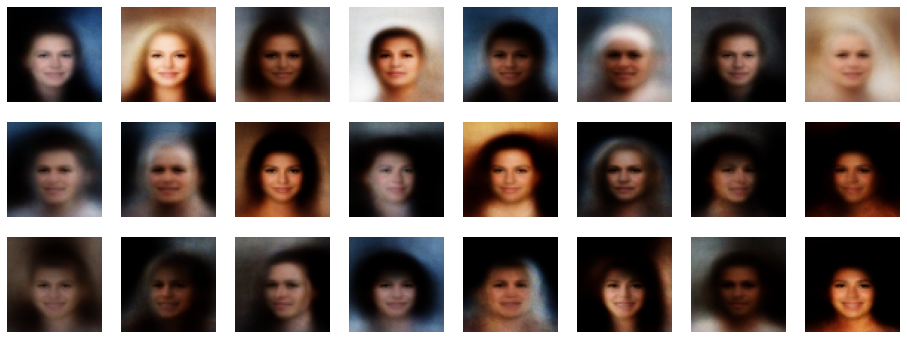

In [ ]:
draw_random_Celeba_VAE(CelebaVAE, 3, 20)
draw_random_Celeba_VAE(CelebaVAE2, 3, 30)

In [ ]:
def combine_rand_Celeb(VAE_, first, second, dataset=cool_celeba_dataset):
    height, width = 1, 5
    size = 5

    first_mu, first_gamma = VAE_.encode(dataset[first].to(device))
    emb_first =  VAE_.reparameterize(first_mu, first_gamma).cpu().detach().numpy()
    second_mu, second_gamma = VAE_.encode(dataset[second].to(device))
    emb_second =  VAE_.reparameterize(second_mu, second_gamma).cpu().detach().numpy()

    plt.figure(figsize=(10, 2))
    for i in range(0, size):
        P = i * (1 / (size - 1))
        which_one = np.random.choice([0, 1], size=emb_first.shape[1],
                                     p=[1 - P, P])
         
        X =  torch.from_numpy(np.choose(which_one, [emb_first, emb_second]))[0]
        new_X =  VAE_.decode(X.to(device)).cpu()

        plt.subplot(height, width, i + 1)
        plt.imshow(new_X[0].permute(1, 2, 0).detach().numpy())
        plt.axis('off')

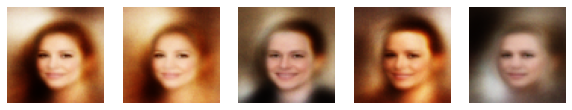

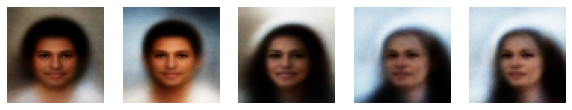

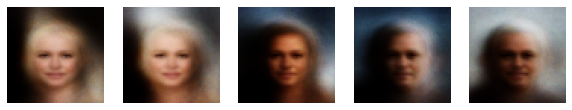

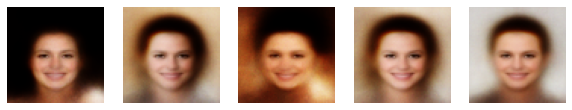

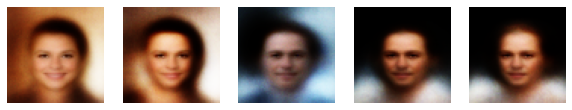

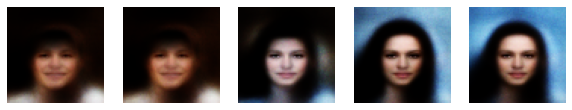

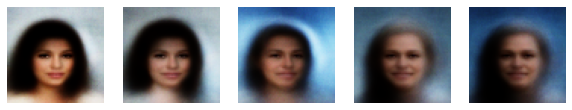

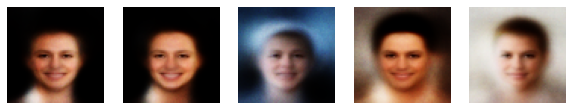

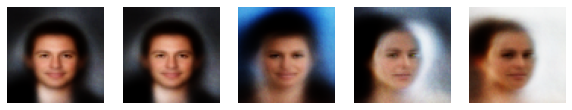

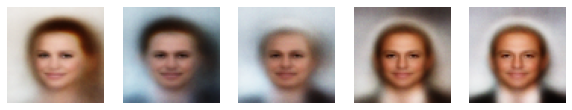

In [ ]:
for i in range(0, 1000, 100):
    combine_rand_Celeb(CelebaVAE, i, i + 1)

In [ ]:
def combine_sum_Celeb(VAE_, first, second, dataset=cool_celeba_dataset):
    height, width = 1, 5
    size = 5

    first_mu, first_gamma = VAE_.encode(dataset[first].to(device))
    emb_first =  VAE_.reparameterize(first_mu, first_gamma).cpu().detach().numpy()
    second_mu, second_gamma = VAE_.encode(dataset[second].to(device))
    emb_second =  VAE_.reparameterize(second_mu, second_gamma).cpu().detach().numpy()

    plt.figure(figsize=(10, 2))
    for i in range(0, size):
        P = i * (1 / (size - 1))

        X =  torch.from_numpy((1 - P) * emb_first + P * emb_second)

        new_X =  VAE_.decode(X[0].to(device)).cpu()

        plt.subplot(height, width, i + 1)
        plt.imshow(new_X[0].permute(1, 2, 0).detach().numpy())
        plt.axis('off')

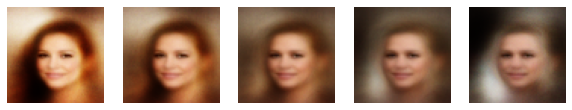

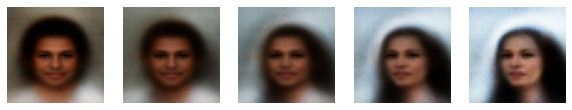

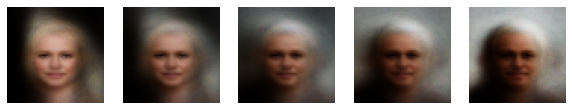

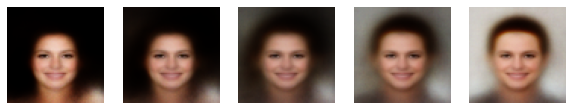

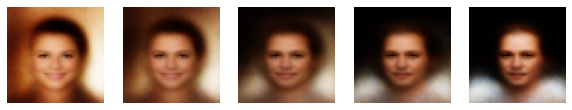

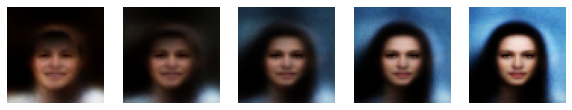

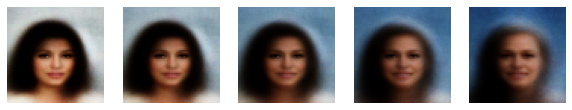

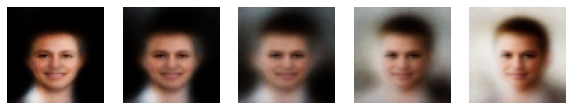

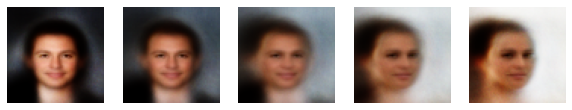

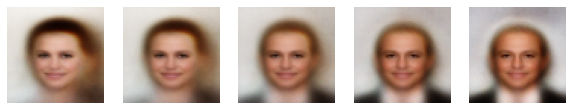

In [ ]:
for i in range(0, 1000, 100):
    combine_sum_Celeb(CelebaVAE, i, i + 1)

203


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  after removing the cwd from sys.path.


/usr/local/lib/python3.6/dist-packages/torch/nn/_reduction.py:44: UserWarning: size_average and reduce args will be deprecated, please use reduction='sum' instead.
  warnings.warn(warning.format(ret))


epoch 1 : 50


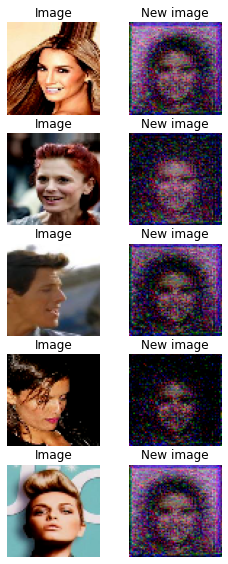

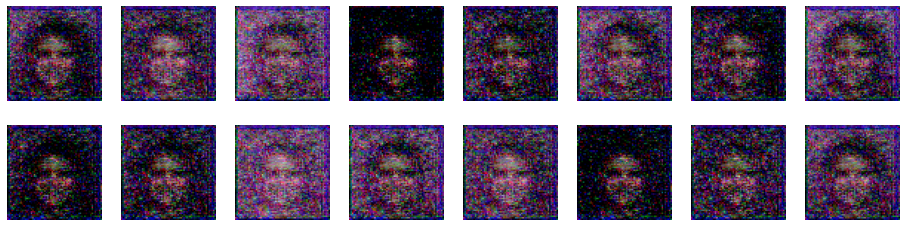

epoch 1 : 100


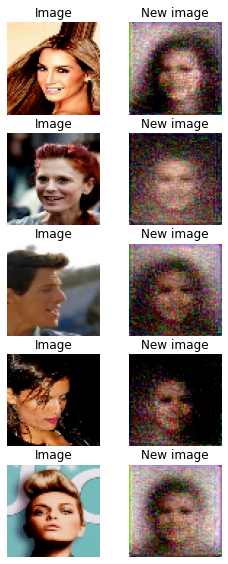

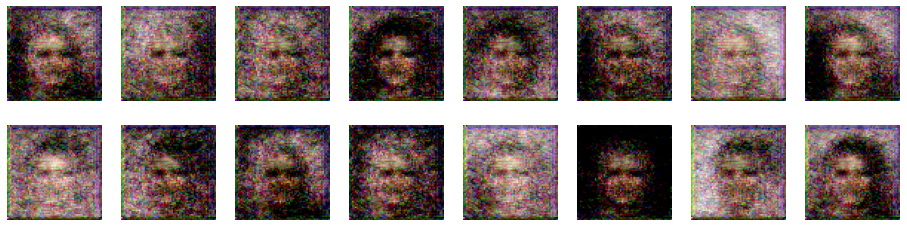

epoch 1 : 150


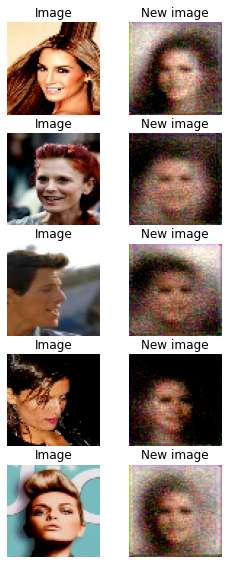

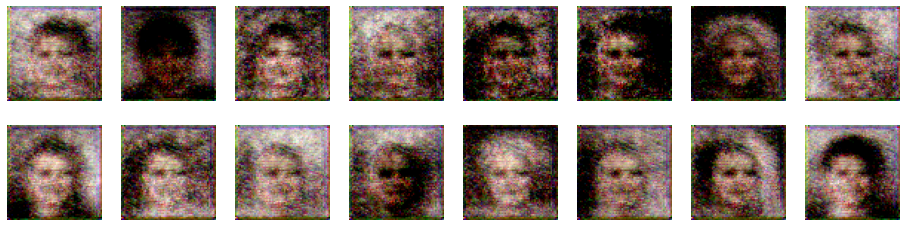

epoch 1 : 200


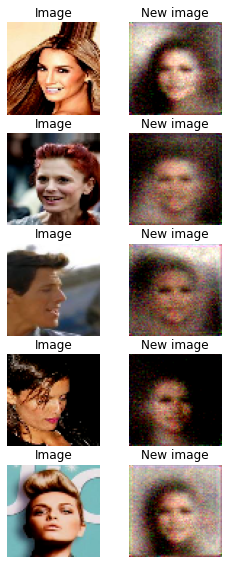

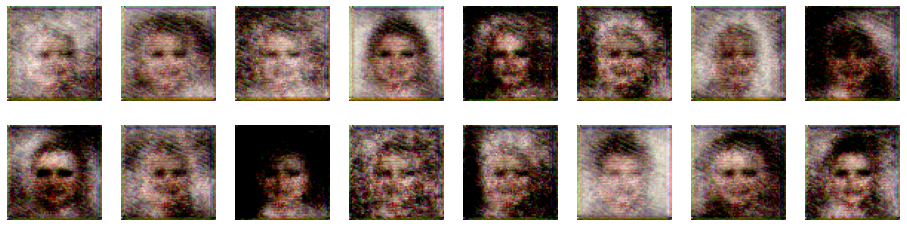

error 1875.7367610837439



epoch 2 : 50


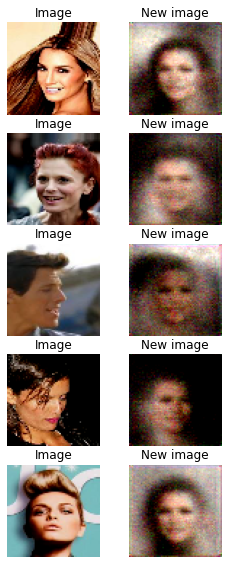

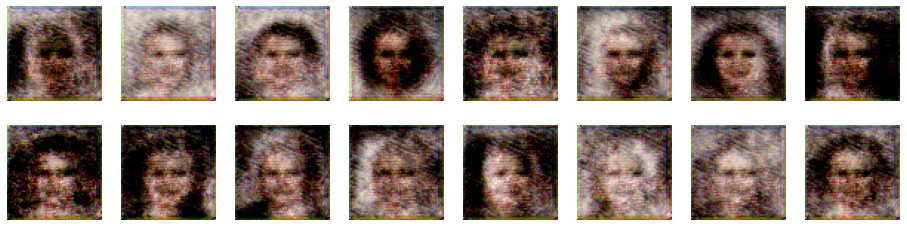

epoch 2 : 100


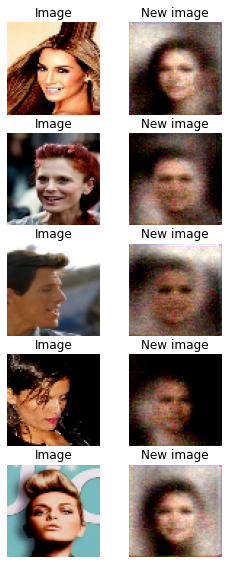

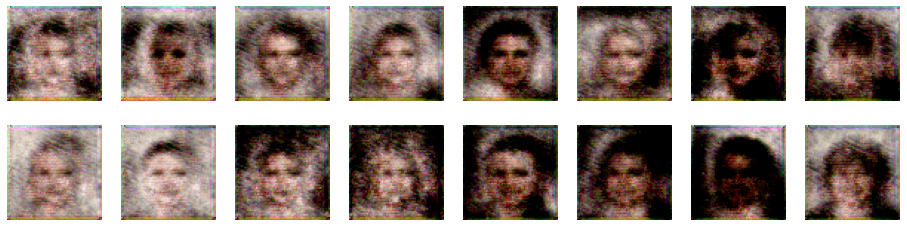

epoch 2 : 150


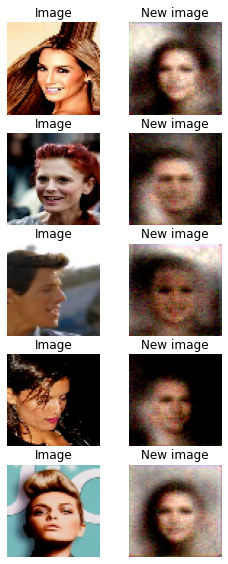

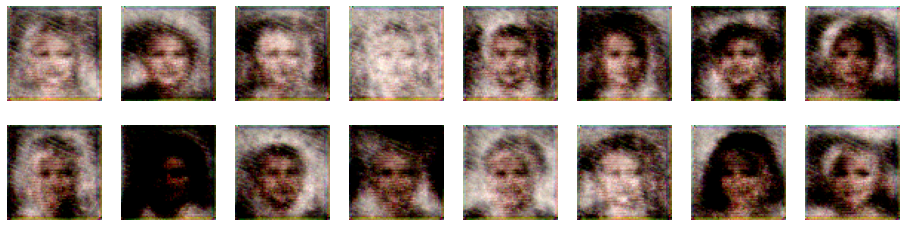

epoch 2 : 200


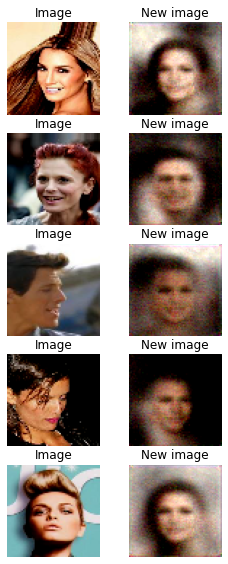

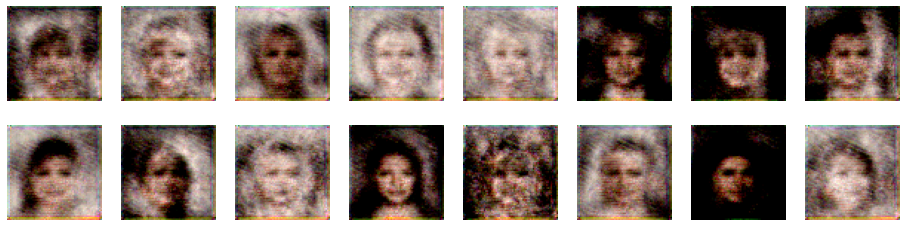

error 1508.217672413793



epoch 3 : 50


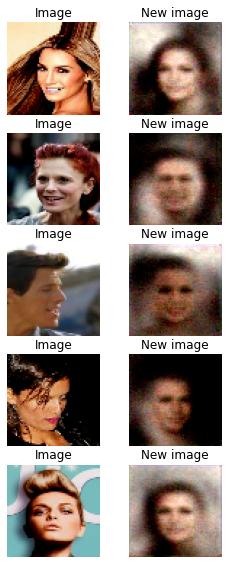

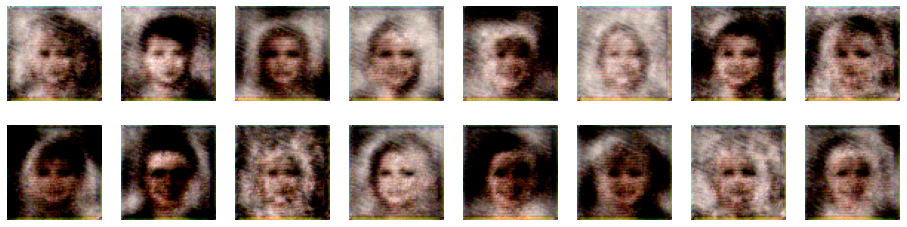

epoch 3 : 100


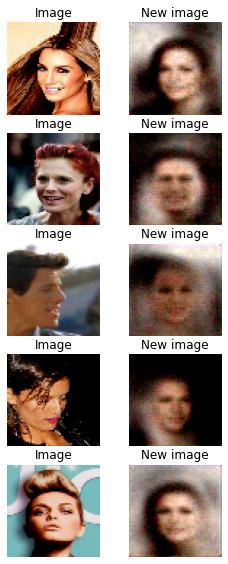

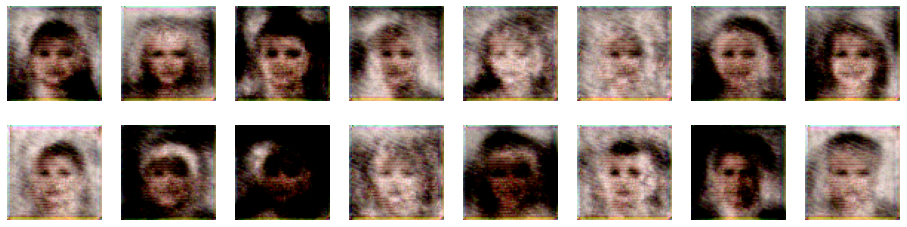

epoch 3 : 150


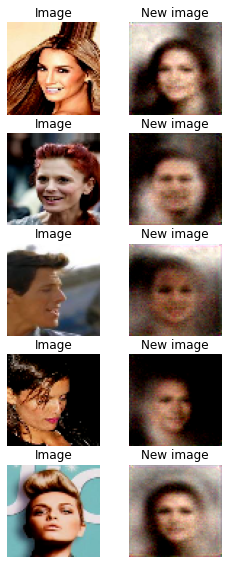

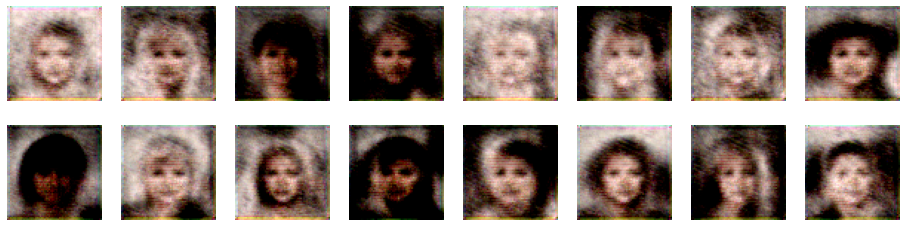

epoch 3 : 200


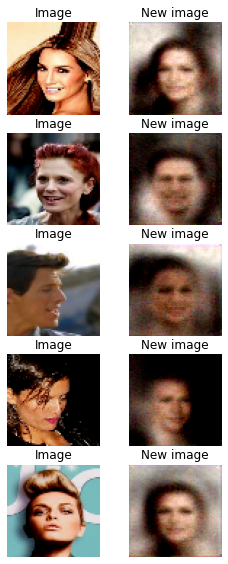

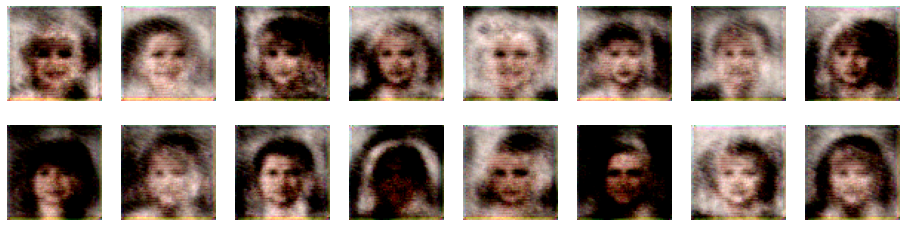

error 1365.7179802955666



epoch 4 : 50


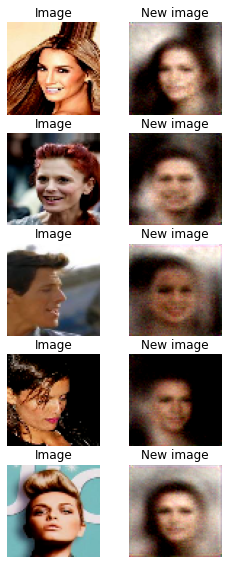

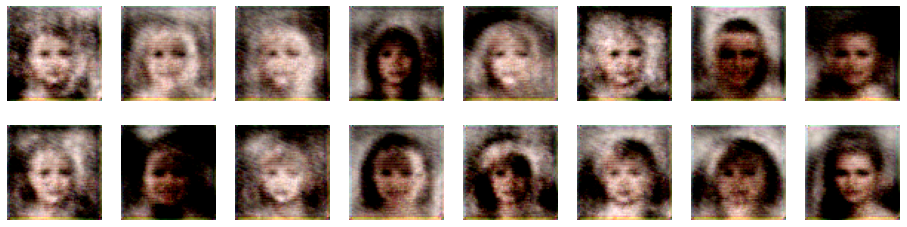

epoch 4 : 100


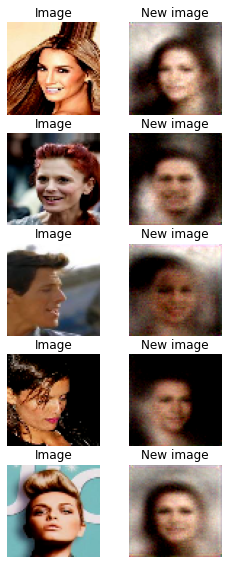

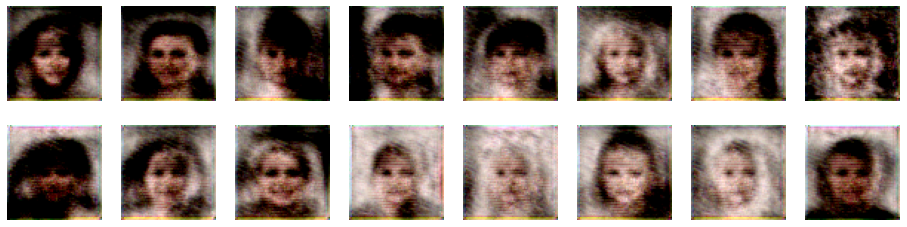

epoch 4 : 150


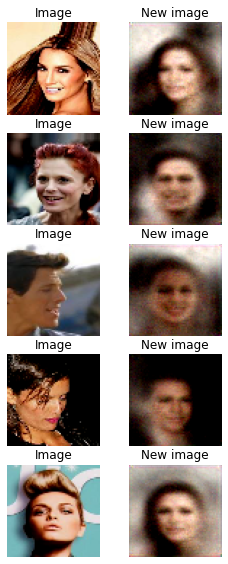

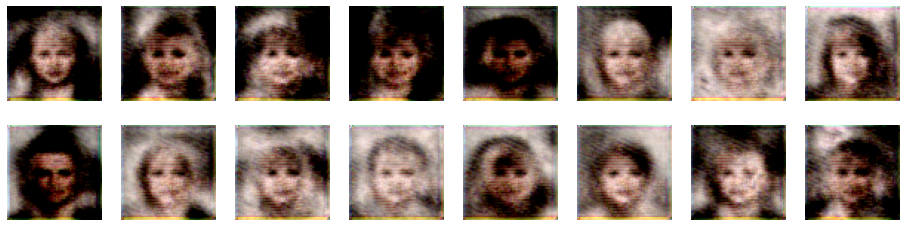

epoch 4 : 200


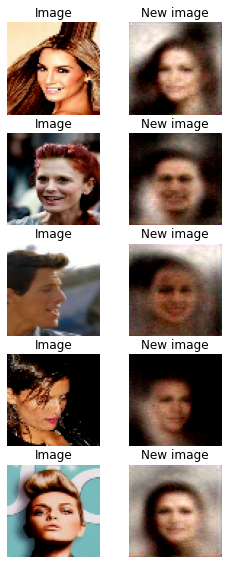

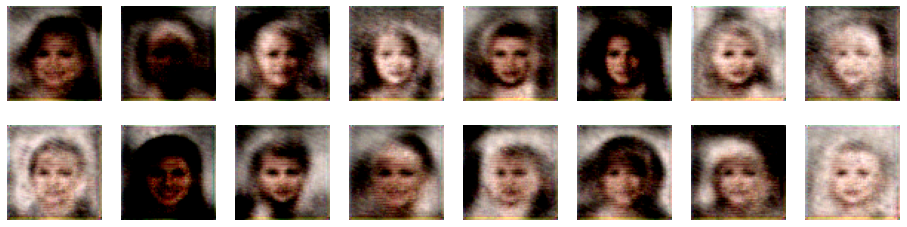

error 1283.2741687192117



epoch 5 : 50


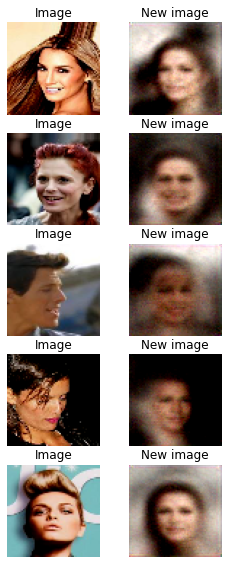

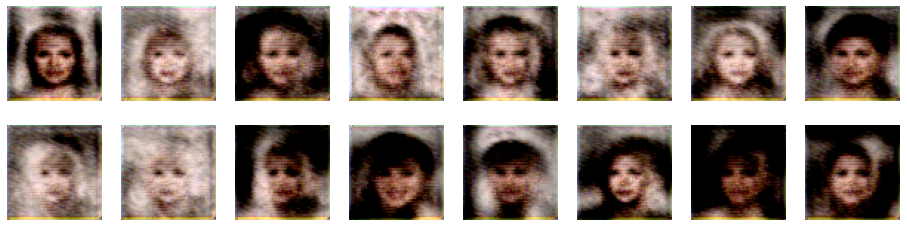

epoch 5 : 100


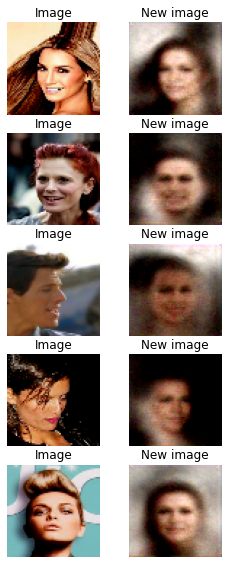

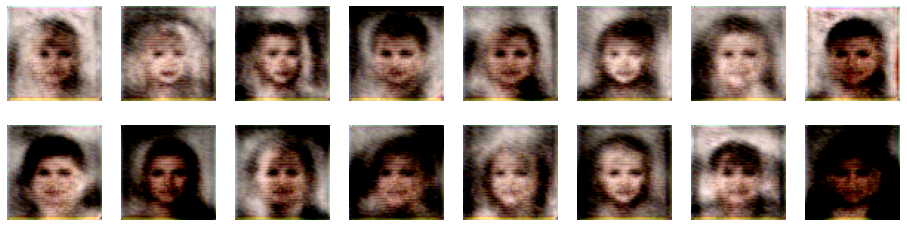

epoch 5 : 150


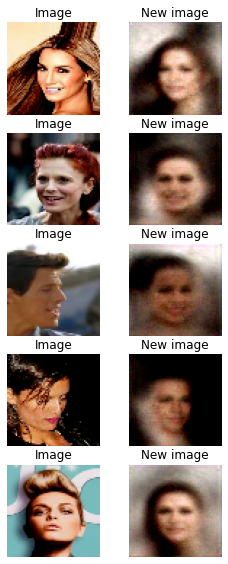

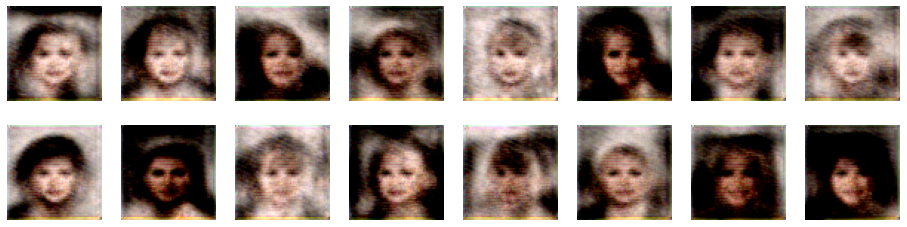

epoch 5 : 200


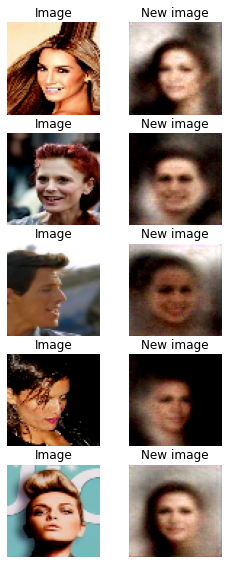

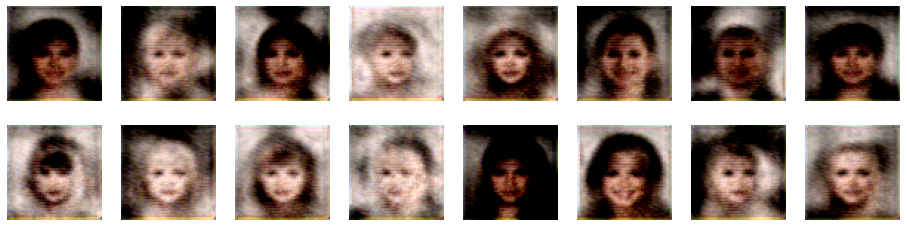

error 1295.0951354679803


In [33]:
class CoolCelebaVAE(nn.Module):
    def __init__(self):
        super(CoolCelebaVAE, self).__init__()
        self.size = 3 * 64 * 64
        
        self.encoder = nn.Sequential(
            nn.Conv2d(in_channels=3,
                               out_channels=8,
                               kernel_size=3, 
                               stride=1,
                               padding=1),
            nn.BatchNorm2d(8),
            nn.ReLU(),
            nn.Conv2d(in_channels=8,
                               out_channels=16,
                               kernel_size=3, 
                               stride=1,
                               padding=1),
            nn.BatchNorm2d(16),
            nn.ReLU(),
            nn.Conv2d(in_channels=16,
                               out_channels=1,
                               kernel_size=3, 
                               stride=1,
                               padding=1)
        )

        self.mu = nn.Linear(1 * 64 * 64, 30)
        self.gamma = nn.Linear(1 * 64 * 64, 30)
        
        self.decoder1 = nn.Sequential(
            nn.Linear(30, 256),
            nn.ReLU(),
            nn.Linear(256, 512),
            nn.ReLU(),
            nn.Linear(512, 1 * 64 * 64),
            nn.Sigmoid()
        )

        self.decoder2 = nn.Sequential(
            nn.ConvTranspose2d(in_channels=1,
                               out_channels=16,
                               kernel_size=3, 
                               stride=1,
                               padding=1),
            nn.ReLU(),
            nn.BatchNorm2d(16),
            nn.ConvTranspose2d(in_channels=16,
                               out_channels=8,
                               kernel_size=3, 
                               stride=1,
                               padding=1),
            nn.ReLU(),
            nn.BatchNorm2d(8),
            nn.ConvTranspose2d(in_channels=8,
                               out_channels=3,
                               kernel_size=3, 
                               stride=1,
                               padding=1),
        )
        
    def encode(self, X):
        X = self.encoder(X)
        X = X.view(-1, 1 * 64 * 64)
        mu = self.mu(X)
        gamma = self.gamma(X)
        return mu, gamma
    
    def reparameterize(self, mu, gamma):
        sigma = torch.exp(0.5 * gamma)
        eps = torch.randn_like(sigma)
        return eps.mul(sigma).add(mu)
        
    def decode(self, X):
        X = self.decoder1(X)
        X = X.view(-1, 1, 64, 64)
        X = self.decoder2(X)
        X = X.view(-1, 3, 64, 64)
        return X
        
    def forward(self, X):
        mu, gamma = self.encode(X)
        X = self.reparameterize(mu, gamma)
        X = self.decode(X)
        return X, mu, gamma

celeba_train = torch.utils.data.DataLoader(cool_celeba_dataset, 
                                                   batch_size=1000, shuffle=True)
print(len(celeba_train))
CoolCelebaVAE = CoolCelebaVAE().to(device)
optimizer = torch.optim.Adam(CoolCelebaVAE.parameters(), lr=1e-3)
Train_Celeba_VAE(CoolCelebaVAE, 10, True, 50, 30)

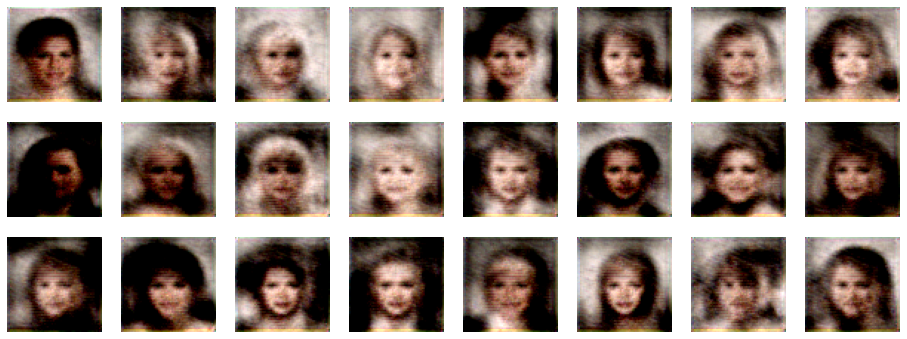

In [36]:
draw_random_Celeba_VAE(CoolCelebaVAE, 3, 30)

1013


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  after removing the cwd from sys.path.


/usr/local/lib/python3.6/dist-packages/torch/nn/_reduction.py:44: UserWarning: size_average and reduce args will be deprecated, please use reduction='sum' instead.
  warnings.warn(warning.format(ret))


epoch 1 : 250


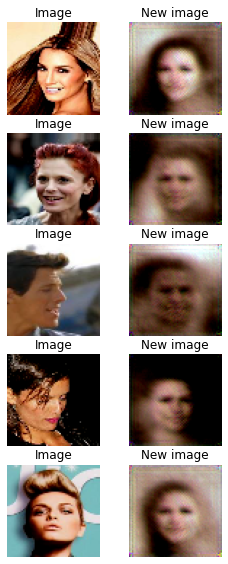

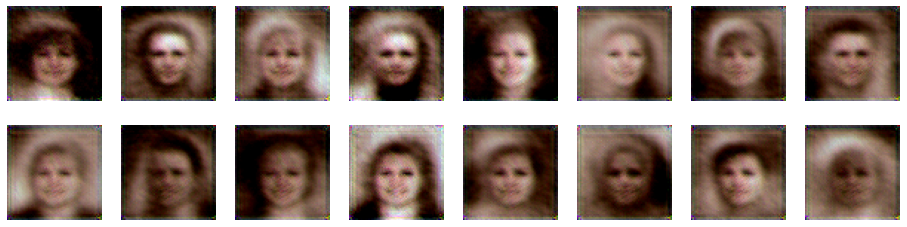

epoch 1 : 500


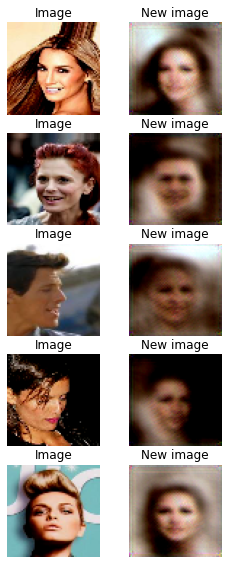

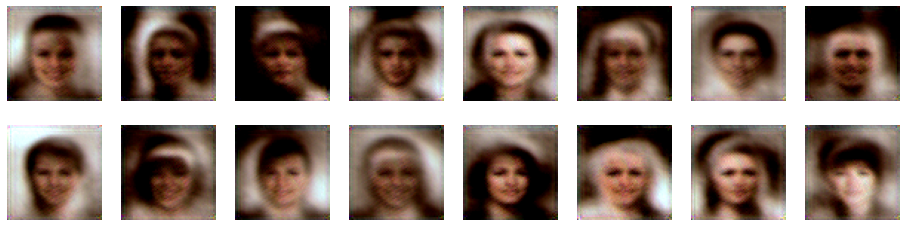

epoch 1 : 750


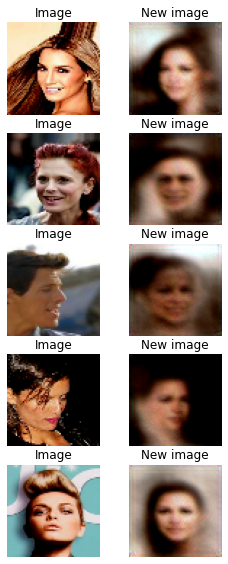

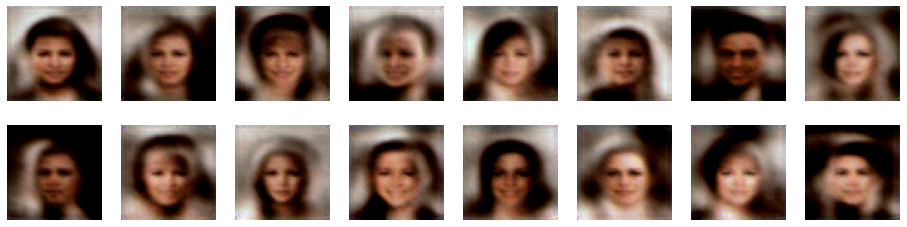

epoch 1 : 1000


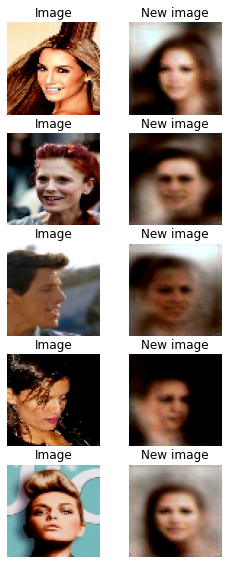

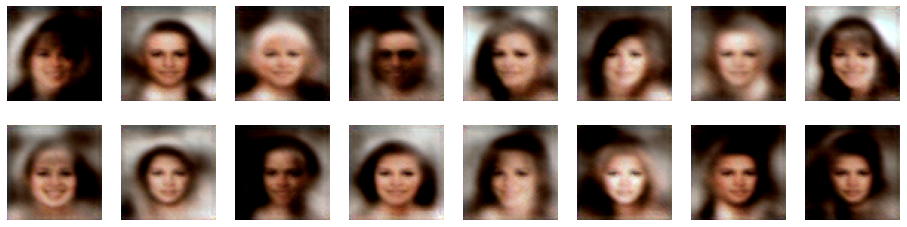

error 82.82917386475815



epoch 2 : 250


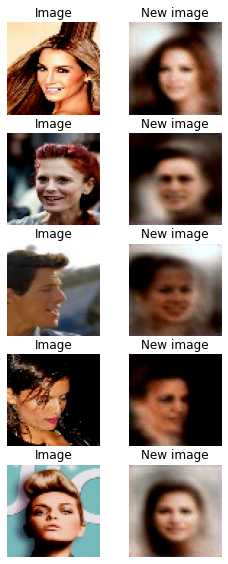

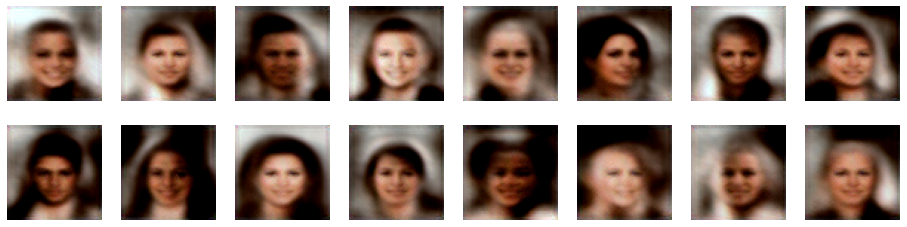

epoch 2 : 500


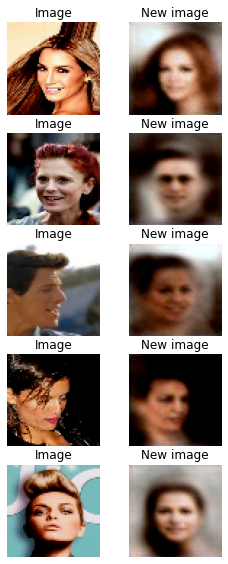

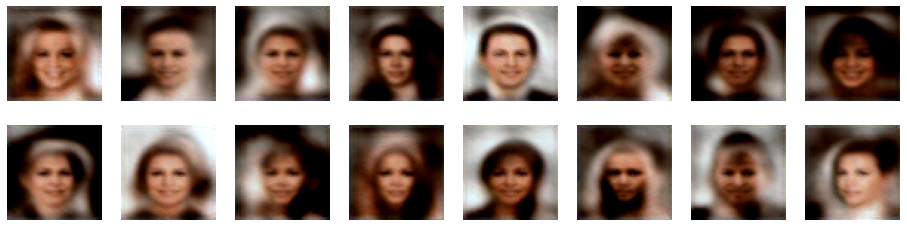

epoch 2 : 750


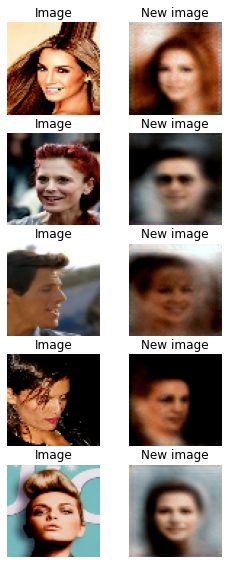

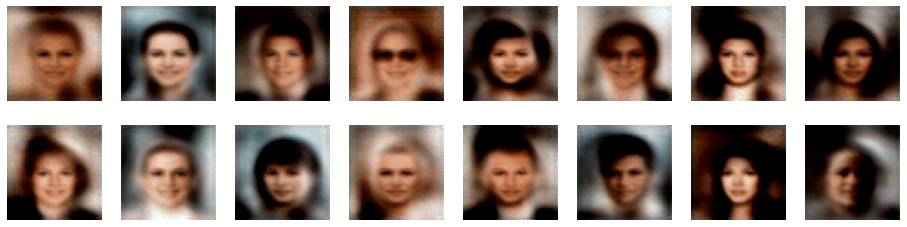

epoch 2 : 1000


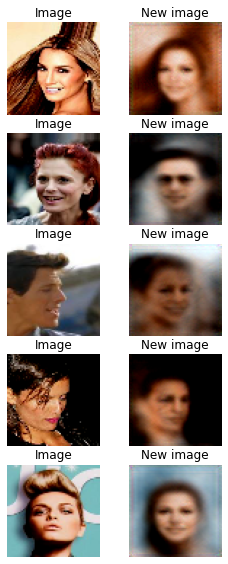

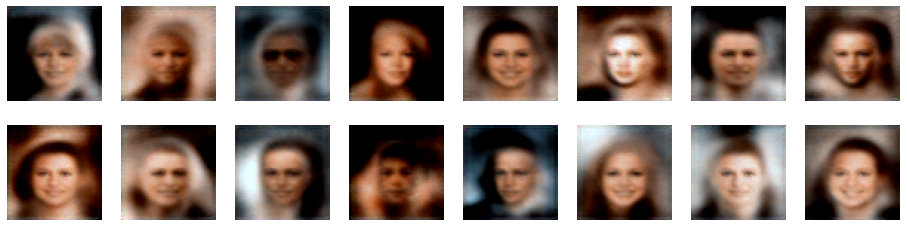

error 79.37920317127345



epoch 3 : 250


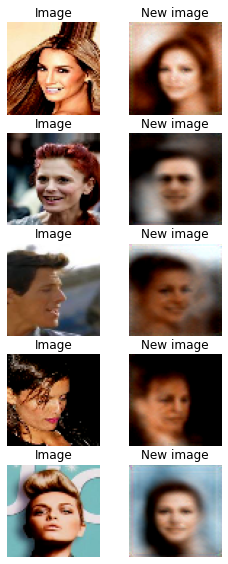

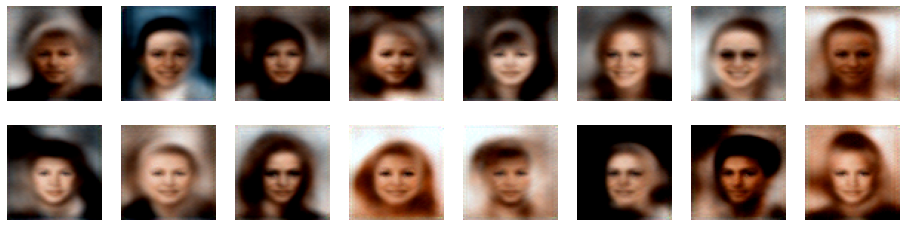

epoch 3 : 500


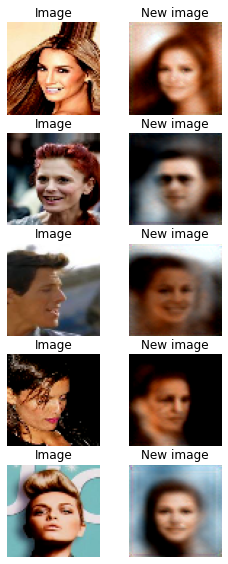

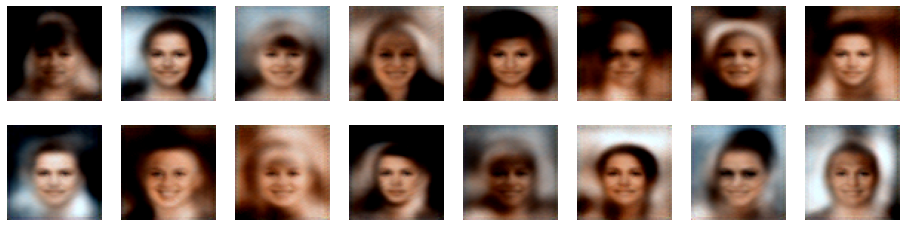

epoch 3 : 750


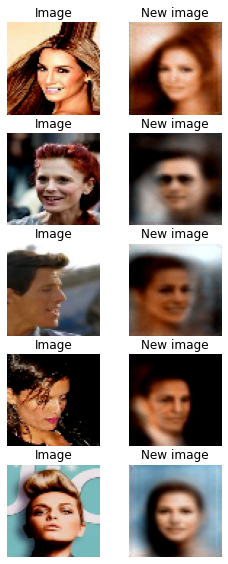

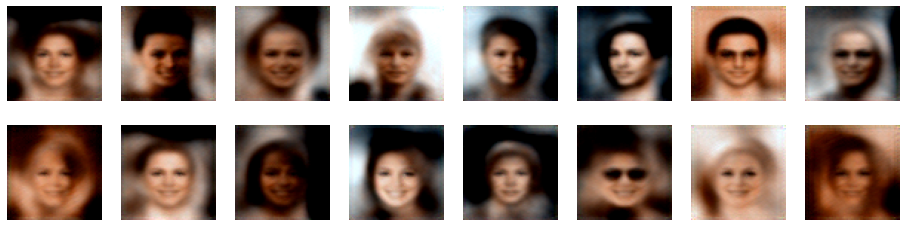

epoch 3 : 1000


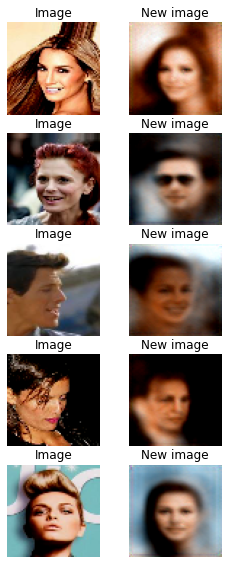

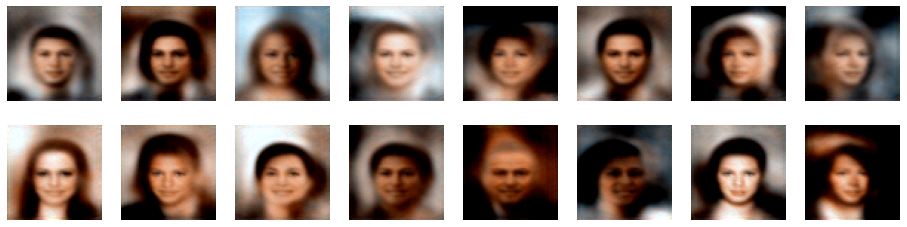

error 74.84456749753208



epoch 4 : 250


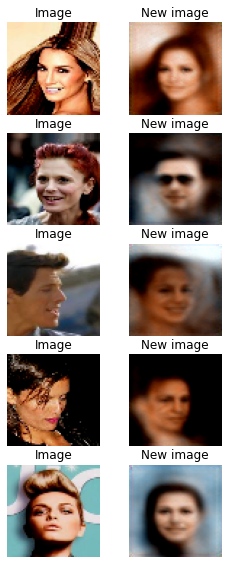

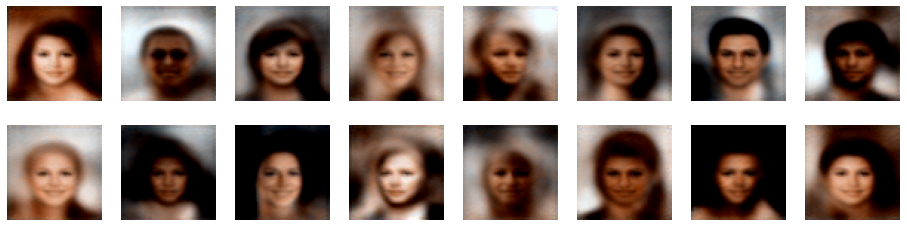

epoch 4 : 500


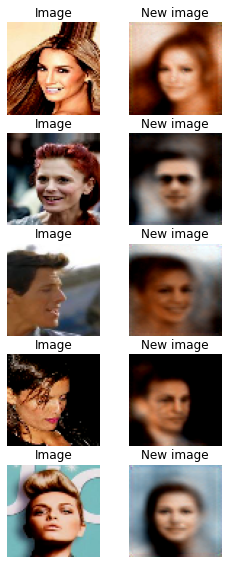

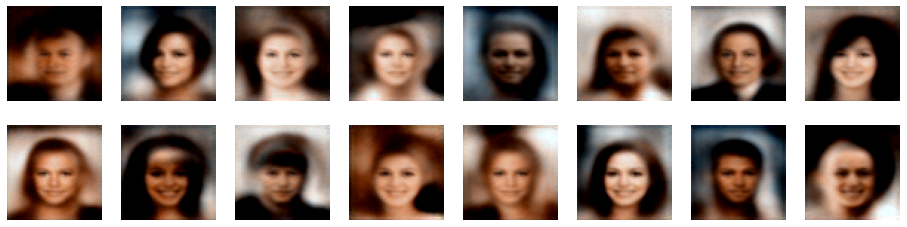

epoch 4 : 750


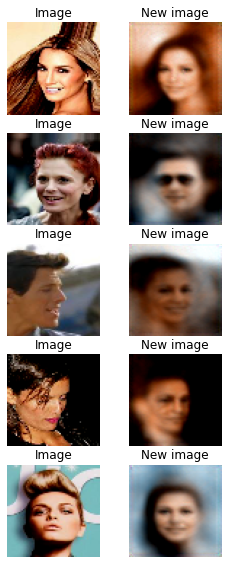

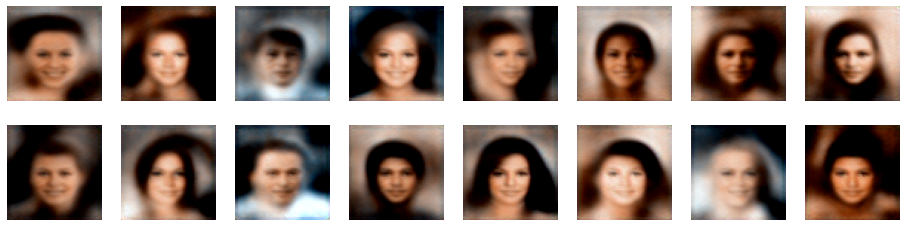

epoch 4 : 1000


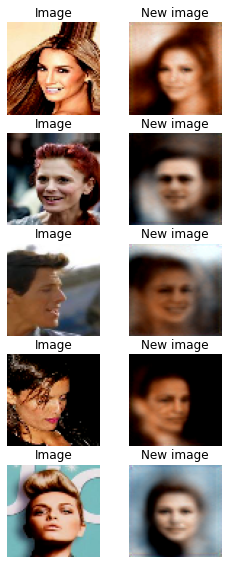

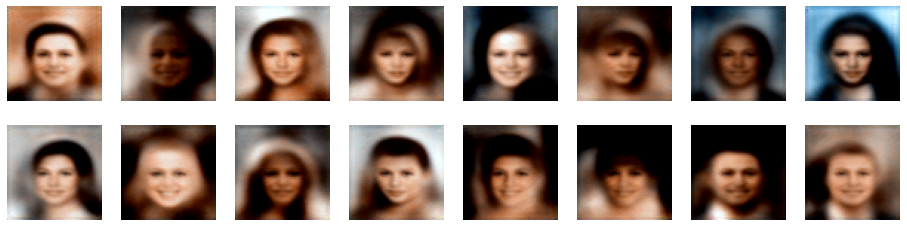

error 77.85424635982231


In [55]:
class CoolCelebaVAE(nn.Module):
    def __init__(self):
        super(CoolCelebaVAE, self).__init__()
        self.size = 3 * 64 * 64
        
        self.encoder = nn.Sequential(
            nn.Conv2d(in_channels=3,
                               out_channels=8,
                               kernel_size=3, 
                               stride=1,
                               padding=1),
            nn.BatchNorm2d(8),
            nn.ReLU(),
            nn.Conv2d(in_channels=8,
                               out_channels=16,
                               kernel_size=3, 
                               stride=1,
                               padding=1),
            nn.BatchNorm2d(16),
            nn.ReLU(),
            nn.Conv2d(in_channels=16,
                               out_channels=1,
                               kernel_size=3, 
                               stride=1,
                               padding=1)
        )

        self.mu = nn.Linear(1 * 64 * 64, 30)
        self.gamma = nn.Linear(1 * 64 * 64, 30)
        
        self.decoder1 = nn.Sequential(
            nn.Linear(30, 256),
            nn.ReLU(),
            nn.Linear(256, 512),
            nn.ReLU(),
            nn.Linear(512, 1 * 64 * 64),
            nn.Sigmoid()
        )

        self.decoder2 = nn.Sequential(
            nn.ConvTranspose2d(in_channels=1,
                               out_channels=16,
                               kernel_size=3, 
                               stride=1,
                               padding=1),
            nn.ReLU(),
            nn.BatchNorm2d(16),
            nn.ConvTranspose2d(in_channels=16,
                               out_channels=8,
                               kernel_size=3, 
                               stride=1,
                               padding=1),
            nn.ReLU(),
            nn.BatchNorm2d(8),
            nn.ConvTranspose2d(in_channels=8,
                               out_channels=3,
                               kernel_size=3, 
                               stride=1,
                               padding=1),
        )
        
    def encode(self, X):
        X = self.encoder(X)
        X = X.view(-1, 1 * 64 * 64)
        mu = self.mu(X)
        gamma = self.gamma(X)
        return mu, gamma
    
    def reparameterize(self, mu, gamma):
        sigma = torch.exp(0.5 * gamma)
        eps = torch.randn_like(sigma)
        return eps.mul(sigma).add(mu)
        
    def decode(self, X):
        X = self.decoder1(X)
        X = X.view(-1, 1, 64, 64)
        X = self.decoder2(X)
        X = X.view(-1, 3, 64, 64)
        return X
        
    def forward(self, X):
        mu, gamma = self.encode(X)
        X = self.reparameterize(mu, gamma)
        X = self.decode(X)
        return X, mu, gamma
        
celeba_train = torch.utils.data.DataLoader(cool_celeba_dataset, 
                                                   batch_size=200, shuffle=True)
print(len(celeba_train))
CoolCelebaVAE = CoolCelebaVAE().to(device)
optimizer = torch.optim.Adam(CoolCelebaVAE.parameters(), lr=1e-3)
Train_Celeba_VAE(CoolCelebaVAE, 5, True, 250, 30)

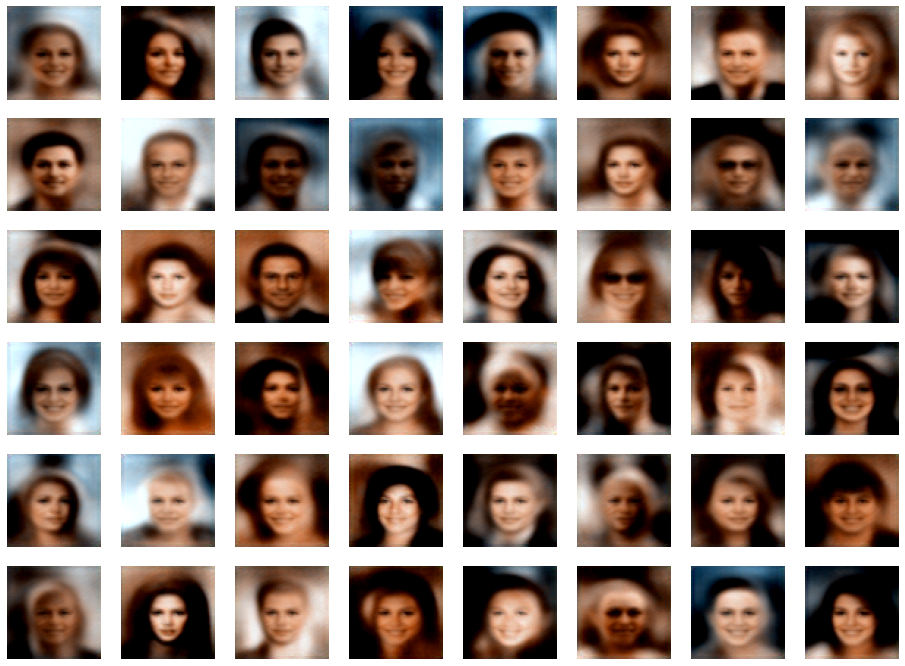

In [69]:
draw_random_Celeba_VAE(CoolCelebaVAE, 6, 30)

1013


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  after removing the cwd from sys.path.


/usr/local/lib/python3.6/dist-packages/torch/nn/_reduction.py:44: UserWarning: size_average and reduce args will be deprecated, please use reduction='sum' instead.
  warnings.warn(warning.format(ret))


epoch 1 : 250


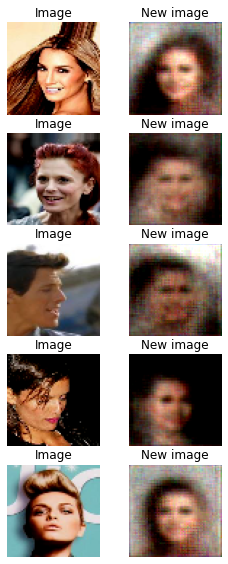

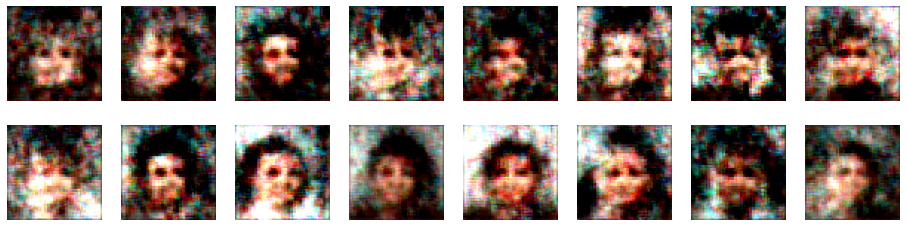

epoch 1 : 500


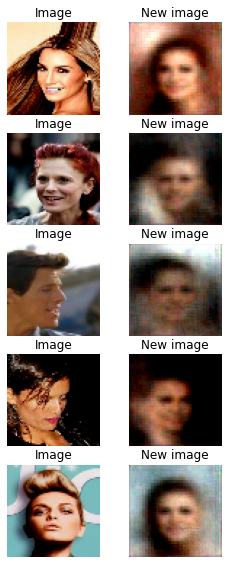

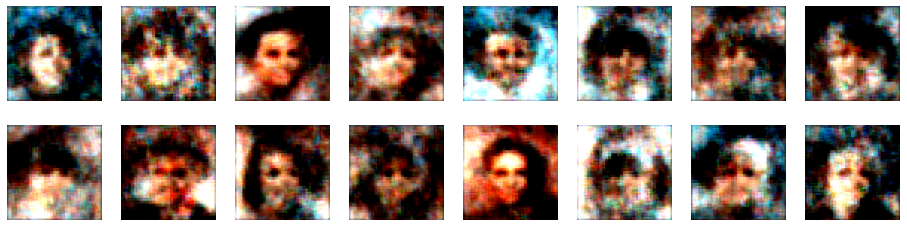

epoch 1 : 750


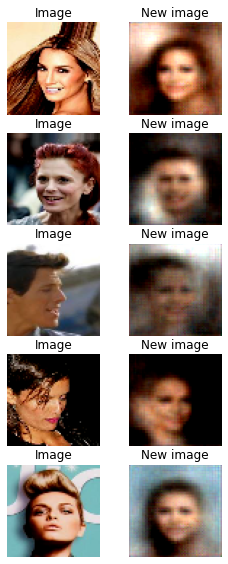

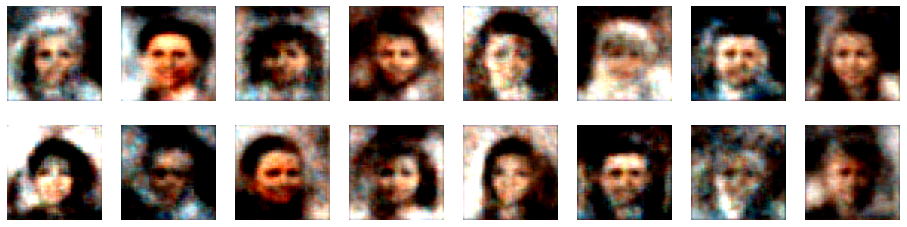

epoch 1 : 1000


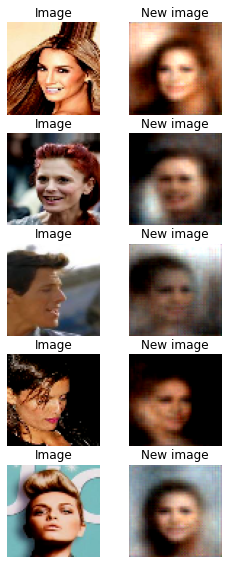

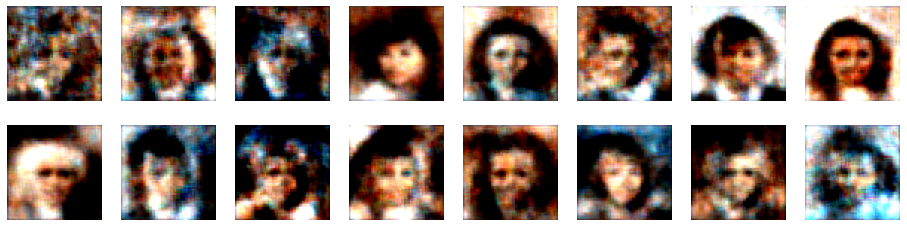

error 82.8937793065153



epoch 2 : 250


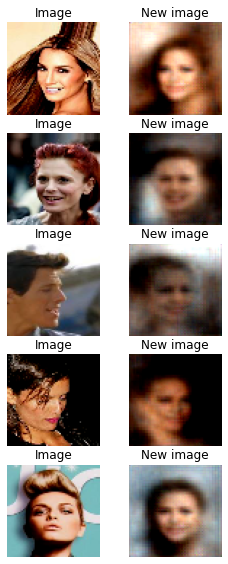

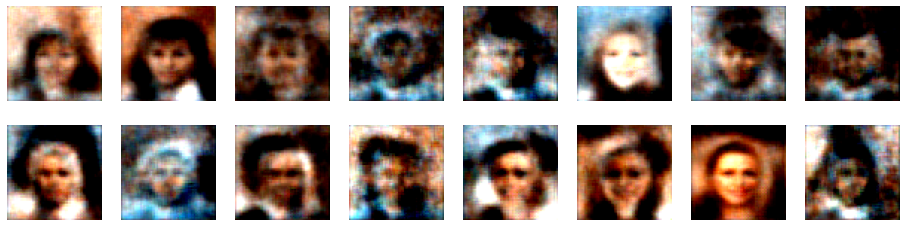

epoch 2 : 500


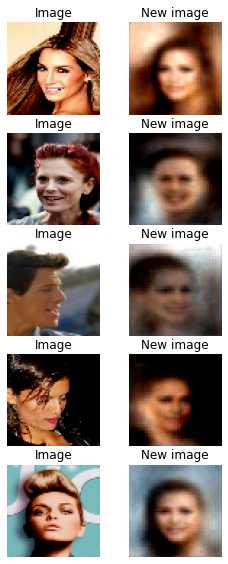

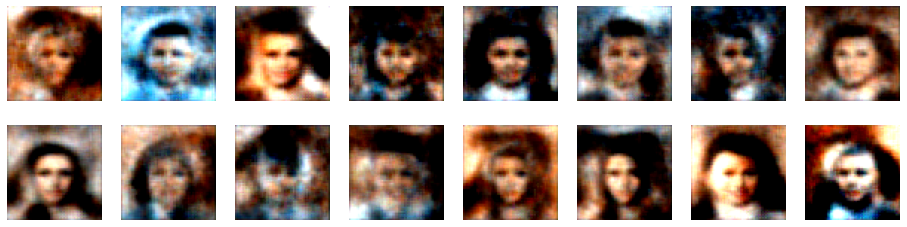

epoch 2 : 750


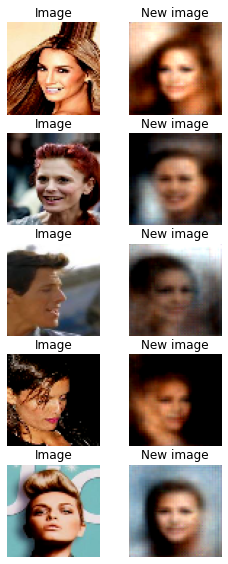

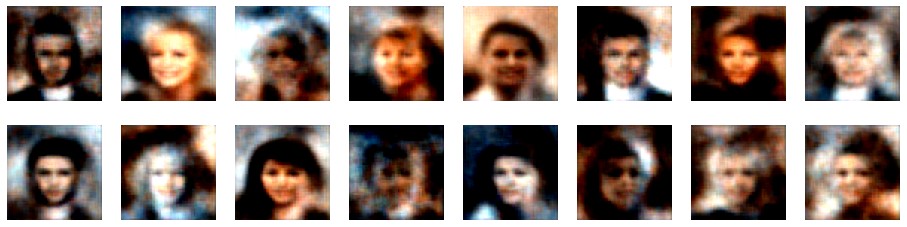

epoch 2 : 1000


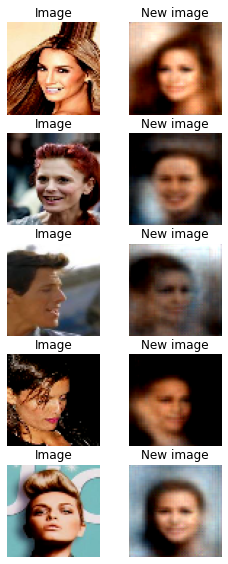

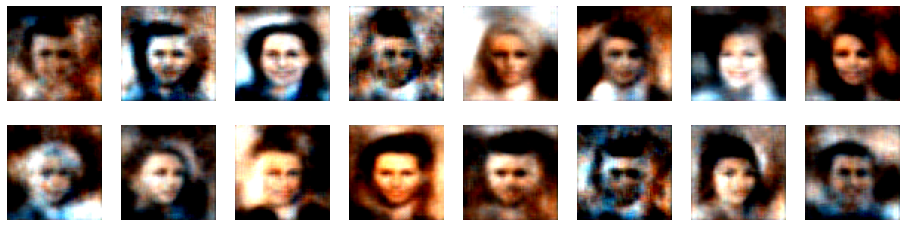

error 77.94013758637709



epoch 3 : 250


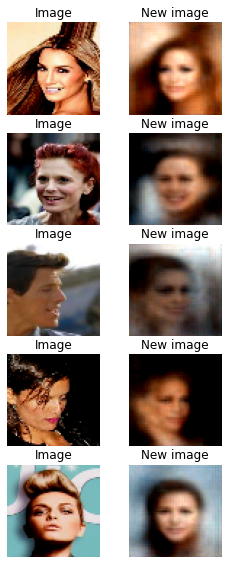

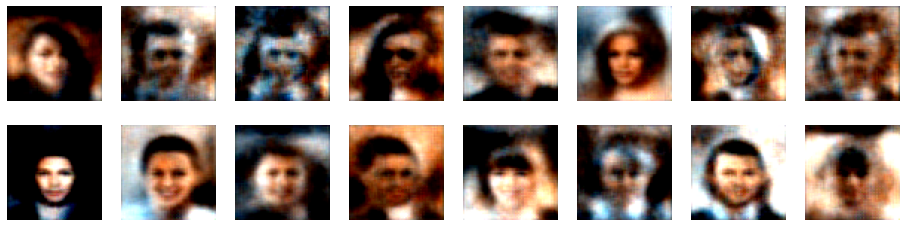

epoch 3 : 500


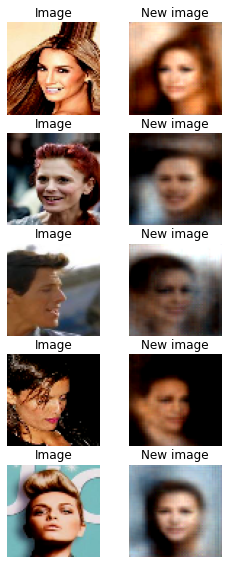

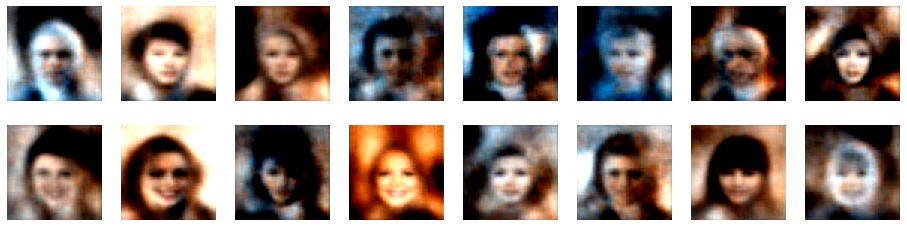

epoch 3 : 750


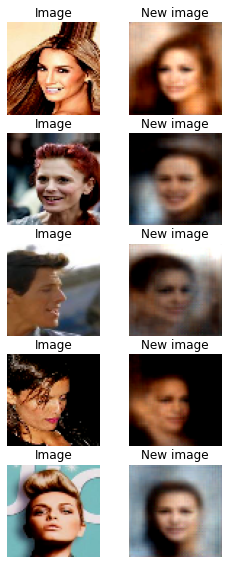

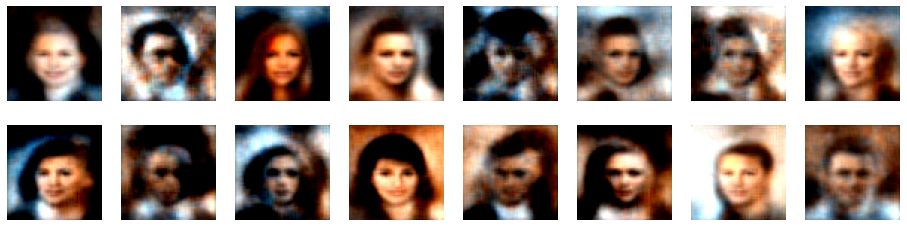

epoch 3 : 1000


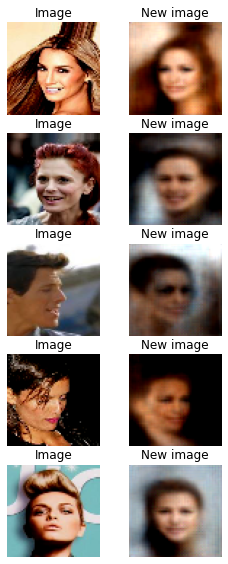

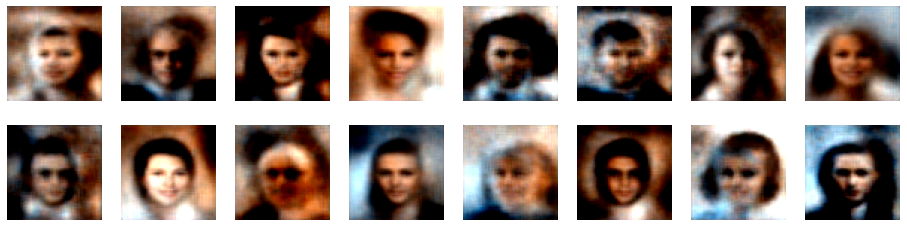

error 78.18264128825271


In [57]:
class CoolCelebaVAE2(nn.Module):
    def __init__(self):
        super(CoolCelebaVAE2, self).__init__()
        self.size = 3 * 64 * 64
        
        self.encoder1 = nn.Sequential(
            #3 * 64 * 64
            nn.Conv2d(in_channels=3,
                               out_channels=8,
                               kernel_size=3, 
                               stride=1,
                               padding=1),
            nn.BatchNorm2d(8),
            nn.ReLU(),
            #8 * 64 * 64
            nn.MaxPool2d(kernel_size=2),
            #8 * 32 * 32
            nn.Conv2d(in_channels=8,
                               out_channels=16,
                               kernel_size=3, 
                               stride=1,
                               padding=1),
            nn.BatchNorm2d(16),
            nn.ReLU(),
            #16 * 32 * 32
            nn.MaxPool2d(kernel_size=2),
            #16 * 16 * 16
        )

        self.encoder2 = nn.Sequential(
            nn.Linear(16 * 16 * 16, 512),
            nn.ReLU(),
            nn.Linear(512, 256),
            nn.ReLU()
        )

        self.mu = nn.Linear(1 * 16 * 16, 30)
        self.gamma = nn.Linear(1 * 16 * 16, 30)
        
        self.decoder1 = nn.Sequential(
            nn.Linear(30, 256),
            nn.ReLU(),
            nn.Linear(256, 16 * 16 * 16)
        )

        self.decoder2 = nn.Sequential(
            #16 * 16 * 16
            nn.Upsample(scale_factor=2),
            #16 * 32 * 32
            nn.ConvTranspose2d(in_channels=16,
                               out_channels=8,
                               kernel_size=3, 
                               stride=1,
                               padding=1),
            nn.ReLU(),
            nn.BatchNorm2d(8),
            #8 * 32 * 32
            nn.Upsample(scale_factor=2),
            #8 * 64 * 64
            nn.ConvTranspose2d(in_channels=8,
                               out_channels=3,
                               kernel_size=3, 
                               stride=1,
                               padding=1),
            #3 * 64 * 64
        )
        
    def encode(self, X):
        X = self.encoder1(X)
        X = X.view(-1, 16 * 16 * 16)
        X = self.encoder2(X)
        mu = self.mu(X)
        gamma = self.gamma(X)
        return mu, gamma
    
    def reparameterize(self, mu, gamma):
        sigma = torch.exp(0.5 * gamma)
        eps = torch.randn_like(sigma)
        return eps.mul(sigma).add(mu)
        
    def decode(self, X):
        X = self.decoder1(X)
        X = X.view(-1, 16, 16, 16)
        X = self.decoder2(X)
        X = X.view(-1, 3, 64, 64)
        return X
        
    def forward(self, X):
        mu, gamma = self.encode(X)
        X = self.reparameterize(mu, gamma)
        X = self.decode(X)
        return X, mu, gamma

celeba_train = torch.utils.data.DataLoader(cool_celeba_dataset, 
                                                   batch_size=200, shuffle=True)
print(len(celeba_train))
CoolCelebaVAE2 = CoolCelebaVAE2().to(device)
optimizer = torch.optim.Adam(CoolCelebaVAE2.parameters(), lr=1e-3)
Train_Celeba_VAE(CoolCelebaVAE2, 5, True, 250, 30)

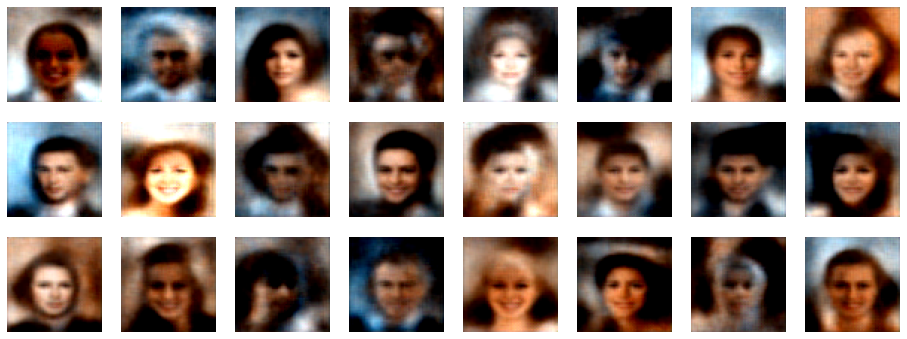

In [68]:
draw_random_Celeba_VAE(CoolCelebaVAE2, 3, 30)

1013


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  after removing the cwd from sys.path.


/usr/local/lib/python3.6/dist-packages/torch/nn/_reduction.py:44: UserWarning: size_average and reduce args will be deprecated, please use reduction='sum' instead.
  warnings.warn(warning.format(ret))


epoch 1 : 250


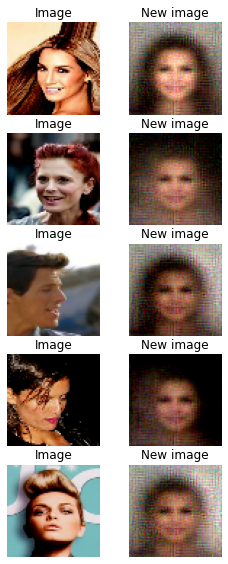

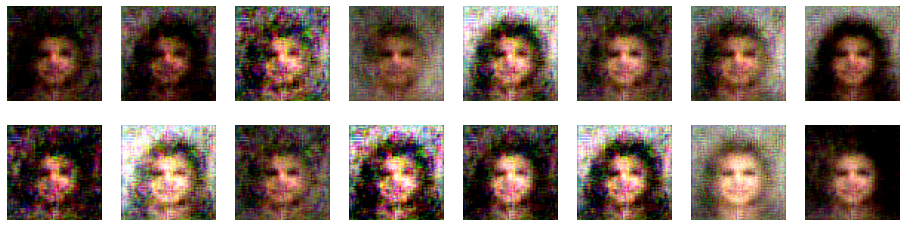

epoch 1 : 500


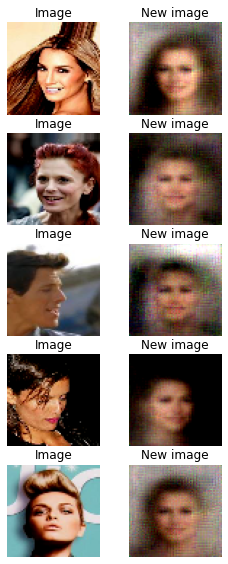

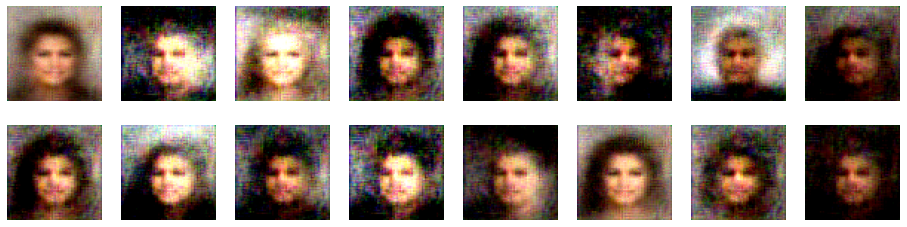

epoch 1 : 750


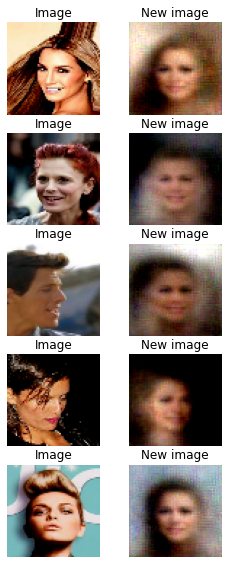

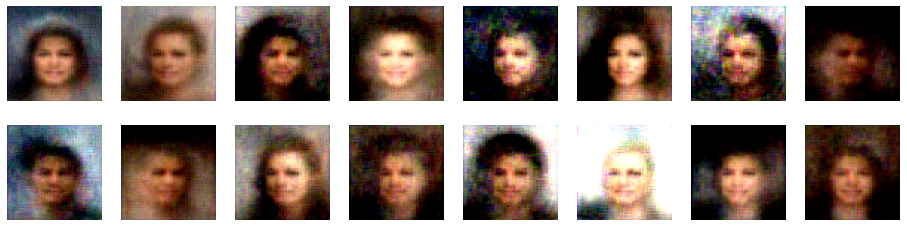

epoch 1 : 1000


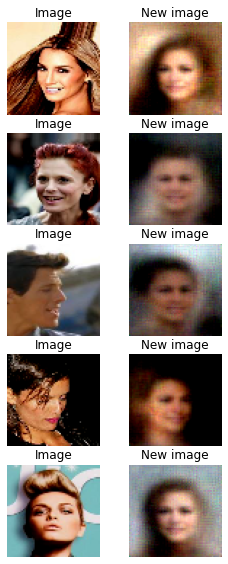

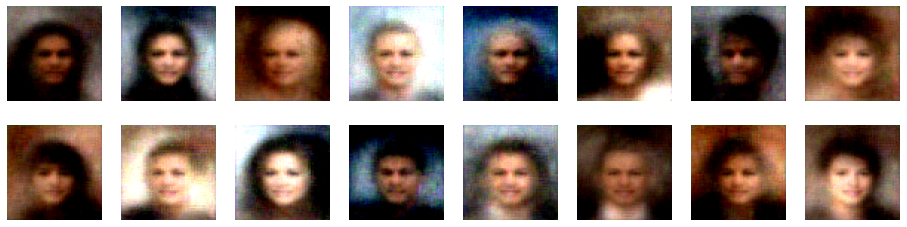

error 98.76068916584403



epoch 2 : 250


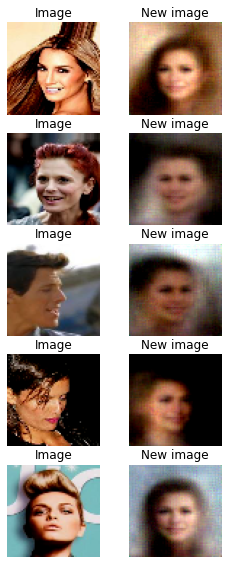

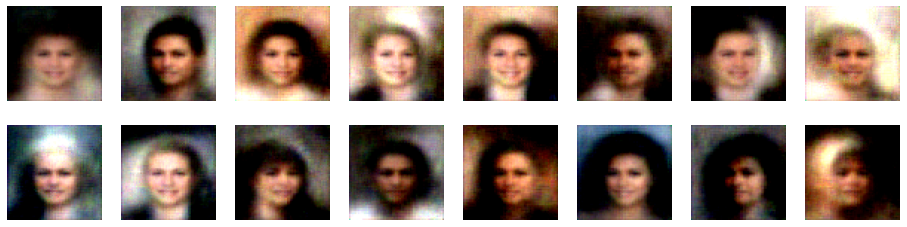

epoch 2 : 500


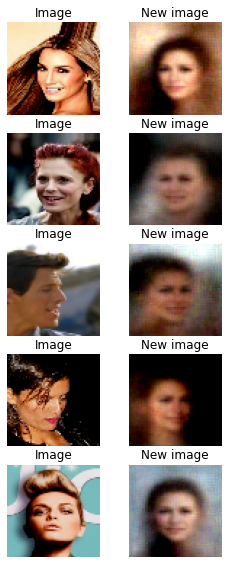

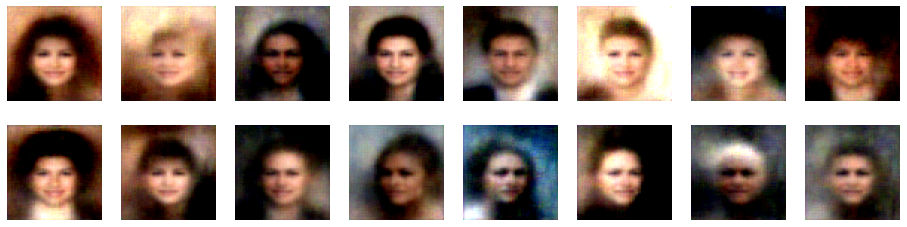

epoch 2 : 750


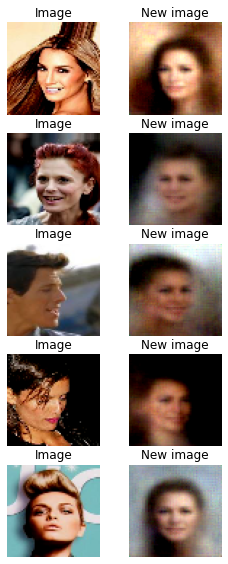

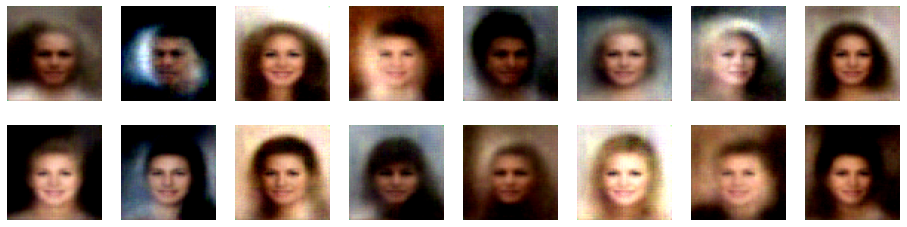

epoch 2 : 1000


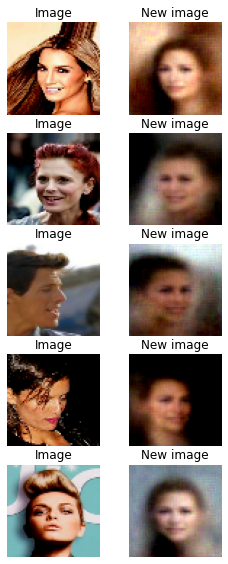

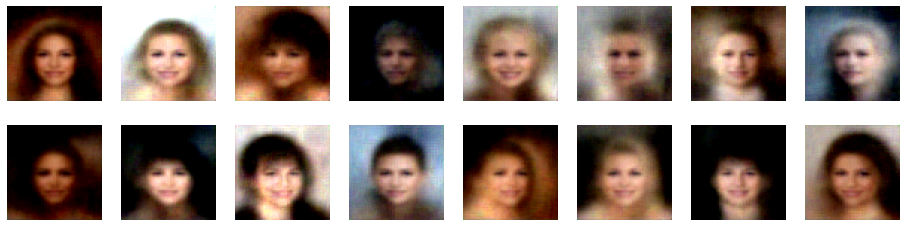

error 89.52456348716683



epoch 3 : 250


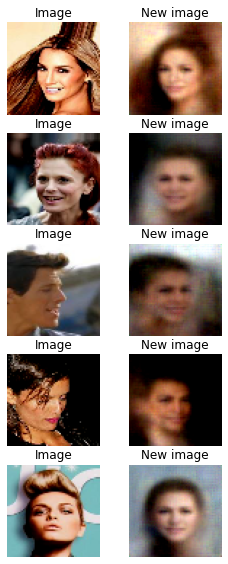

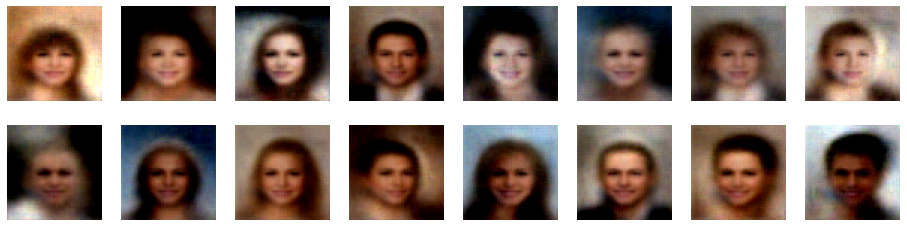

epoch 3 : 500


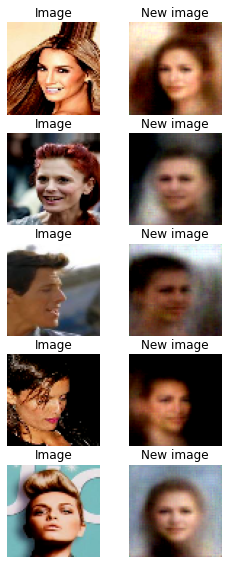

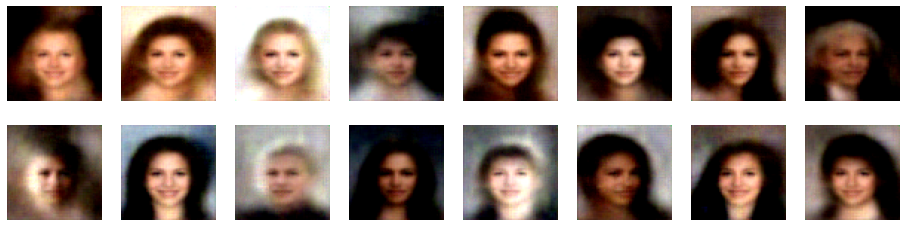

epoch 3 : 750


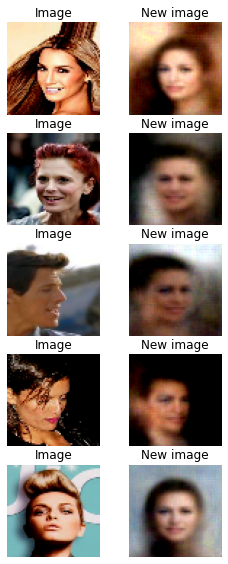

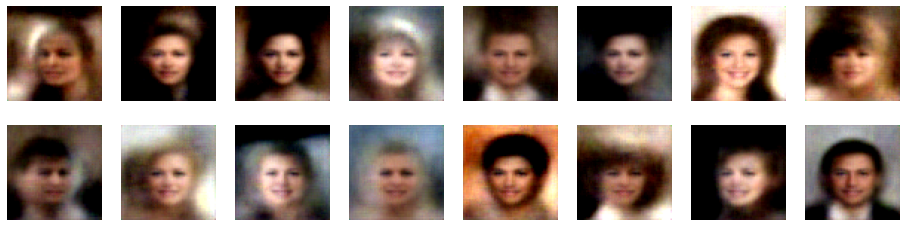

epoch 3 : 1000


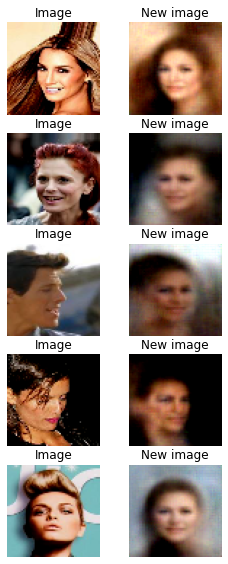

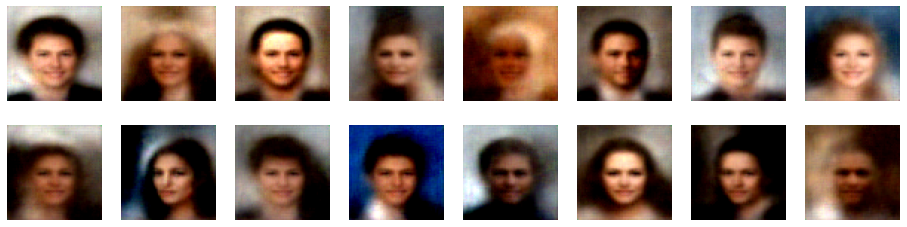

error 83.10903566140178



epoch 4 : 250


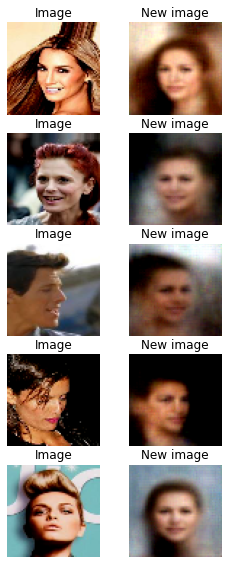

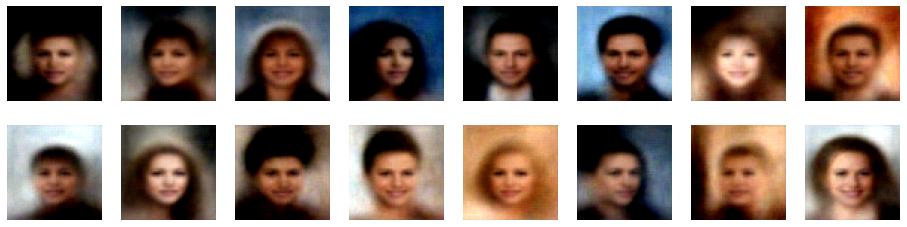

epoch 4 : 500


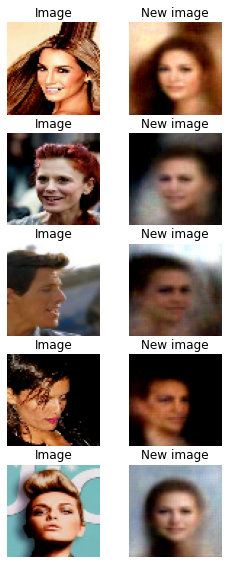

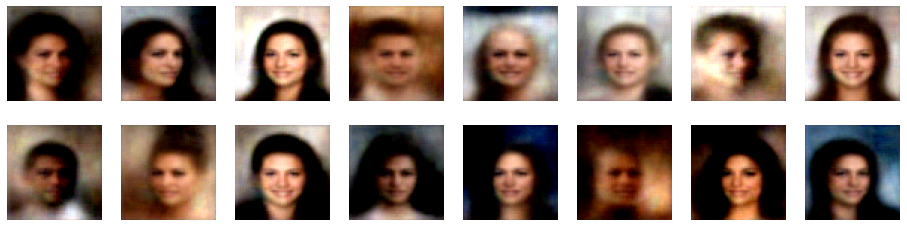

epoch 4 : 750


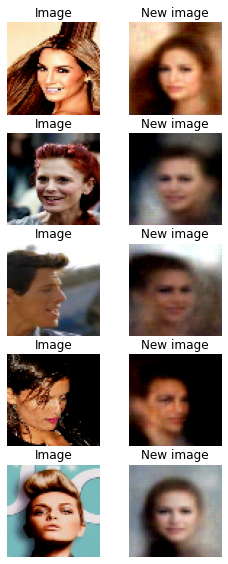

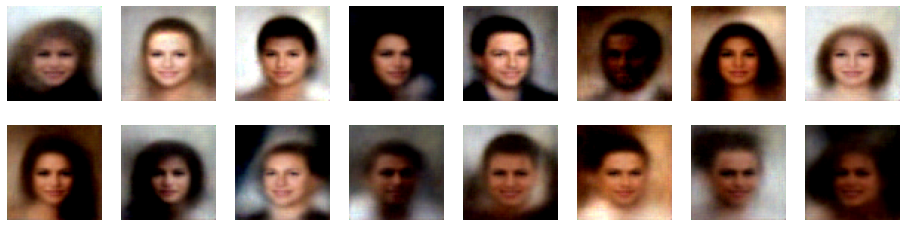

epoch 4 : 1000


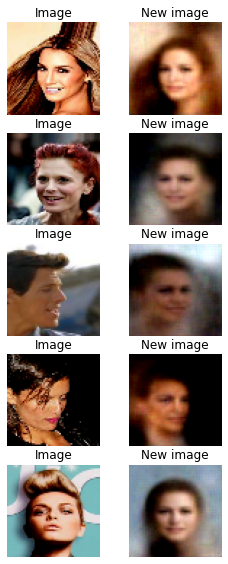

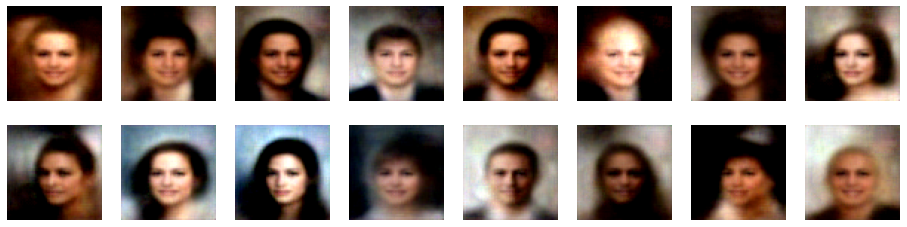

error 83.02528072556763



epoch 5 : 250


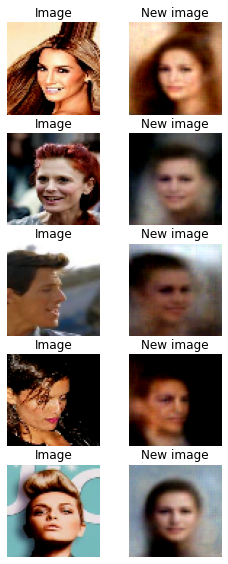

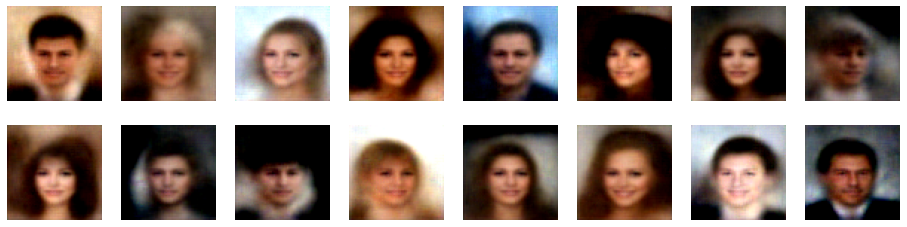

epoch 5 : 500


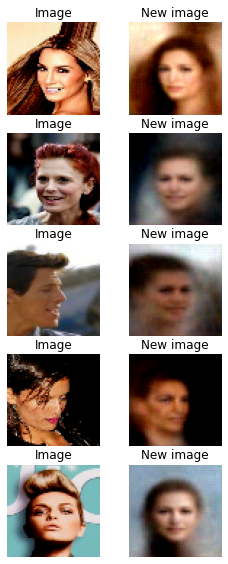

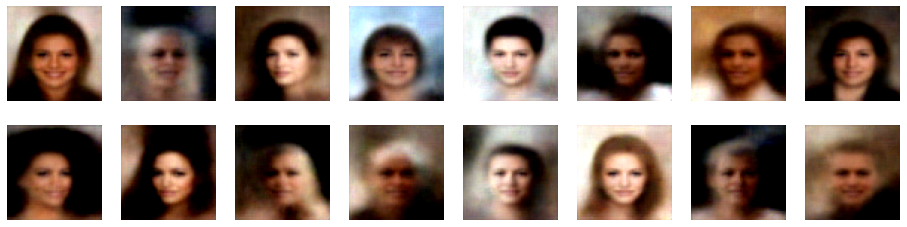

epoch 5 : 750


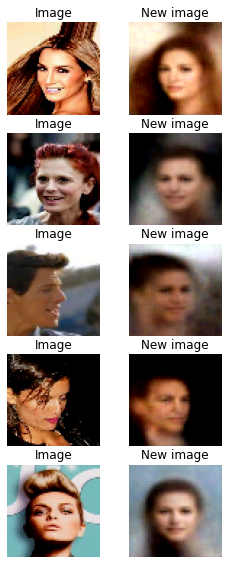

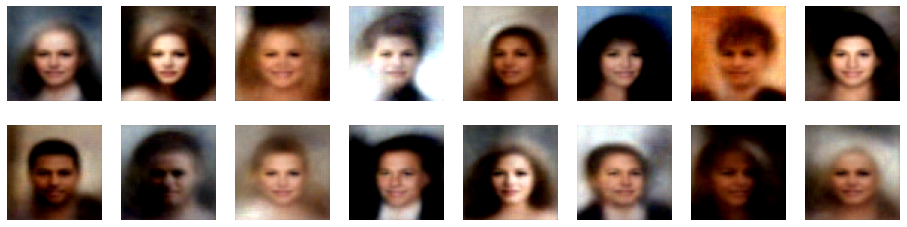

epoch 5 : 1000


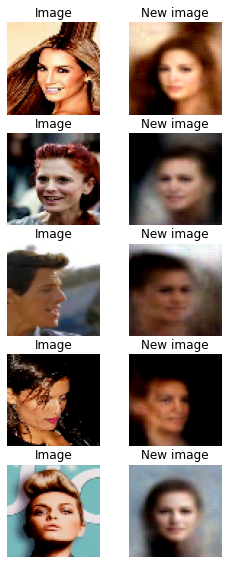

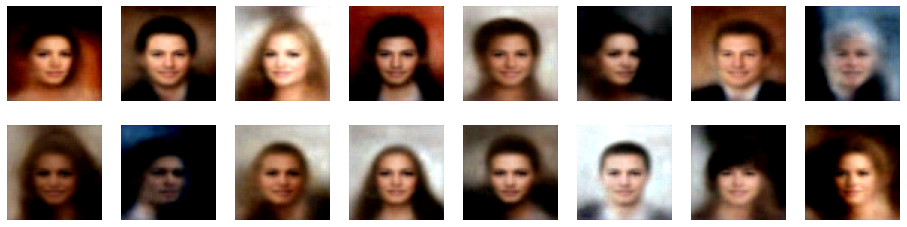

error 80.02736303060217



In [59]:
class CoolCelebaVAE3(nn.Module):
    def __init__(self):
        super(CoolCelebaVAE3, self).__init__()
        self.size = 3 * 64 * 64
        
        self.encoder1 = nn.Sequential(
            #3 * 64 * 64
            nn.Conv2d(in_channels=3,
                               out_channels=16,
                               kernel_size=3, 
                               stride=1,
                               padding=1),
            nn.BatchNorm2d(16),
            nn.ReLU(),
            #16 * 64 * 64
            nn.MaxPool2d(kernel_size=2),
            #16 * 32 * 32
            nn.Conv2d(in_channels=16,
                               out_channels=32,
                               kernel_size=3, 
                               stride=1,
                               padding=1),
            nn.BatchNorm2d(32),
            nn.ReLU(),
            #32 * 32 * 32
            nn.MaxPool2d(kernel_size=2),
            #32 * 16 * 16
        )

        self.encoder2 = nn.Sequential(
            nn.Linear(32 * 16 * 16, 1024),
            nn.ReLU(),
            nn.Linear(1024, 512),
            nn.ReLU(),
            nn.Linear(512, 256),
            nn.ReLU()
        )

        self.mu = nn.Linear(1 * 16 * 16, 20)
        self.gamma = nn.Linear(1 * 16 * 16, 20)
        
        self.decoder1 = nn.Sequential(
            nn.Linear(20, 512),
            nn.ReLU(),
            nn.Linear(512, 1024),
            nn.ReLU(),
            nn.Linear(1024, 32 * 16 * 16)
        )

        self.decoder2 = nn.Sequential(
            #32 * 16 * 16
            nn.Upsample(scale_factor=2),
            #32 * 32 * 32
            nn.ConvTranspose2d(in_channels=32,
                               out_channels=16,
                               kernel_size=3, 
                               stride=1,
                               padding=1),
            nn.ReLU(),
            nn.BatchNorm2d(16),
            #16 * 32 * 32
            nn.Upsample(scale_factor=2),
            #16 * 64 * 64
            nn.ConvTranspose2d(in_channels=16,
                               out_channels=3,
                               kernel_size=3, 
                               stride=1,
                               padding=1),
            #3 * 64 * 64
        )
        
    def encode(self, X):
        X = self.encoder1(X)
        X = X.view(-1, 32 * 16 * 16)
        X = self.encoder2(X)
        mu = self.mu(X)
        gamma = self.gamma(X)
        return mu, gamma
    
    def reparameterize(self, mu, gamma):
        sigma = torch.exp(0.5 * gamma)
        eps = torch.randn_like(sigma)
        return eps.mul(sigma).add(mu)
        
    def decode(self, X):
        X = self.decoder1(X)
        X = X.view(-1, 32, 16, 16)
        X = self.decoder2(X)
        X = X.view(-1, 3, 64, 64)
        return X
        
    def forward(self, X):
        mu, gamma = self.encode(X)
        X = self.reparameterize(mu, gamma)
        X = self.decode(X)
        return X, mu, gamma

celeba_train = torch.utils.data.DataLoader(cool_celeba_dataset, 
                                                   batch_size=200, shuffle=True)
print(len(celeba_train))
CoolCelebaVAE3 = CoolCelebaVAE3().to(device)
optimizer = torch.optim.Adam(CoolCelebaVAE3.parameters(), lr=1e-3)
Train_Celeba_VAE(CoolCelebaVAE3, 5, True, 250, 20)

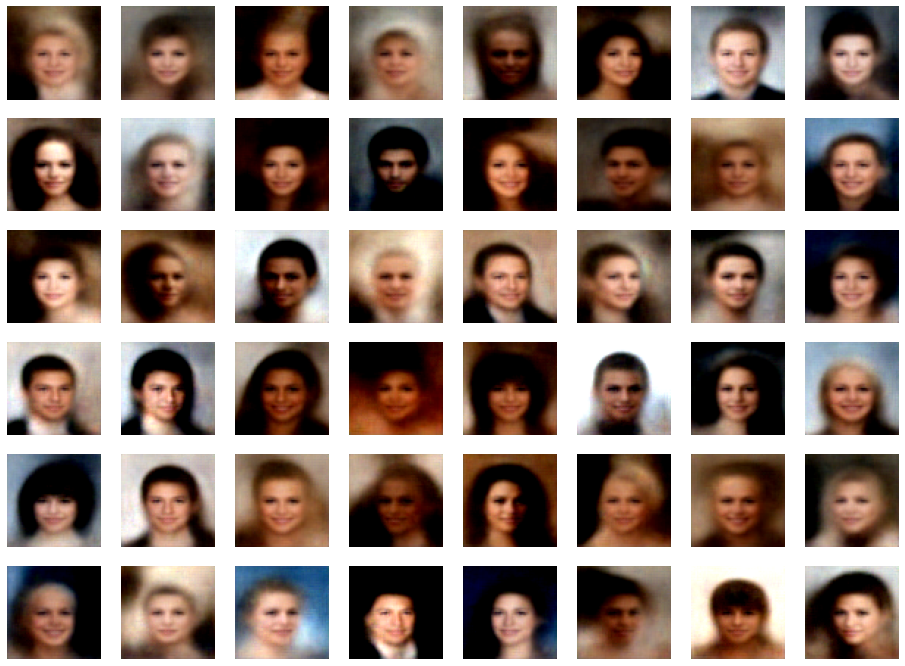

In [64]:
draw_random_Celeba_VAE(CoolCelebaVAE3, 6, 20)